# Background info

### Microphysical parameters (xnames)

Note that the parameter names in the namelist correspond to the microphysics Fortran code, not the Python codes used in ensemble DA experiments. Definitions are as follows:

1. as = a_s, the coefficient in the snow fallspeed-diameter relationship
2. bs = b_s, the exponent in the snow fallspeed-diameter relationship
3. ag = a_g, the coefficient in the graupel fallspeed-diameter relationship
4. bg = b_g, the exponent in the graupel fallspeed-diameter relationship
5. tnw = N_0r, the intercept parameter in the (exponential) rain particle size distribution
6. tns = N_0s, the intercept parameter in the (exponential) snow particle size distribution
7. tng = N_0g, the intercept parameter in the (exponential) graupel particle size distribution
8. roqs = rho_s, the snow density
9. roqg = rho_g, the graupel density
10. bnd21 = q_c0, the cloud-to-rain autoconversion threshold
11. bnd1 = q_i0, the ice-to-snow autoconversion threshold (not used)

### Model output (ynames)

Running the cloud column model (CRM) will produce an ascii file (eg, crm1d_output.txt) containing a row of numbers (the default run contains 36 values in total).

If the model is run for 1 time step only, it will output 6 values corresponding to the following variables:

1. pcp: precipitation rate
2. acc: accumulated precipitation
3. lwp: liquid water path
4. iwp: ice water path
5. olr: outgoing longwave radiation
6. osr: outgoing shortwave radiation

If the model is run for "k" time steps, there will be a total of 6k values, where each set of 6 values (counting from the beginning) will correspond to the 6 variables above. E.g., the second 6-member set (starting from the 7th value and ending in the 12th value), will give the values of {pcp,acc,lwp,iwp,olr,osr} during the second model time step.

In [5]:
#----------------
#    PACKAGES    
#----------------
import time
import os,sys
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
from cloud_column_model import cloud_column_model 
import create_ensemble
from parmap_framework import parmap
from module_runcrm import runcrm


#--------------------------------
#    EXPERIMENT CONFIGURATION         
#--------------------------------

### General
rand_seed = 33; np.random.seed(rand_seed) # set random number seed for reproducibility
num_Workers = 12
np.set_printoptions(precision=5) 
np.set_printoptions(suppress=True) # suppress scientific notation

### Input/output filenames
expdir = './'
input_file = expdir+'cloud_column_model/run_one_crm1d.txt' # in cloud_column_column_model dir; contains reference param vals
output_file = expdir+'cloud_column_model/crm1d_output.txt' # appears in cloud_column_model dir under the name pert_crm1d_output.txt_{num}
                                        # each column shows time evolution for 1 of the 6 model output vars 
namelist_file = expdir+'cloud_column_model/namelist_3h_t30-180.f90'

### Ensembles and distributions
LType = 1 # Gaussian likelihood by default; corresponds to additive and Gaussian noise
ens_gen = 'uniform'
n_ens = 1000  # used in Posselt and Bishop (2018)
p1 = [              200.0,  0.3,  400.0,  0.4,  0.5,    0.5,   0.5,   0.2,     0.4,   1.e-3,  6.e-4 ] # mean parameter used in create_ensemble()
                                                                                                      # to define Gaussian and Gamma distributions
p2 = [              20.0,   0.05, 20.0,   0.05, 0.05,   0.05,  0.05,  0.05,    0.05,  1.e-4,  1.e-5 ] # std parameter used in create_ensemble() 
                                                                                                      # to define Gaussian and Gamma distributions
pmin = [            50.0,   0.10, 50.0,   0.1,  0.05,   0.05,  0.05,  0.05,    0.05,  1.e-4,  2.e-6 ] # lower bound
pmax = [            1000.0, 1.0,  1200.0, 0.90, 5.0,    2.5,   2.5,   1.0,     1.0,   2.e-3,  1.e-3 ] # upper bound

### Parameters and observations
# parameters
xnames = [        'as',   'bs',  'ag',  'bg', 'N0r',  'N0s', 'N0g', 'rhos',  'rhog', 'qc0', 'qi0']
XfMask = np.array([1.0,    1.0,  1.0,    1.0,  1.0,    1.0,   1.0,   1.0,     1.0,    1.0,   1.0])
x_true = [         200.0,  0.3,  400.0,  0.4,  0.5,    0.5,   0.5,   0.2,     0.4,   1.e-3,  6.e-4 ]
nx = len(xnames)
nxp = np.count_nonzero(XfMask) 
xidx = np.squeeze(np.nonzero(XfMask))
# times
tnames =          ['30', '60', '90', '120', '150', '180']
t_mask = np.array([0.0,  0.0,   0.0,  1.0,   0.0,   0.0])
nt = len(tnames)
# observations
ynames =          ['PCP', 'ACC', 'LWP', 'IWP', 'OLR', 'OSR']
y_mask = np.array([ 1.0,   1.0,   1.0,   1.0,   1.0,   1.0])
y_sigma =         [ 2.0,   5.0,   0.5,   1.0,   5.0,   5.0 ] * nt
ynames_long = [f'{y}_t{i}' for i in range(1, nt+1) for y in ynames]
n_obs = len(ynames)

### Full observation space mask
HXfMask = np.empty(n_obs * nt)
for t in range(nt):
  for o in range(n_obs):
    idx = (t * n_obs) + o
    HXfMask[idx] = t_mask[t] * y_mask[o]

In [6]:
#--------------------------------
#    MODEL SIMULATIONS         
#--------------------------------

### Generate prior ensemble X
print('Generating the prior ensemble')
p1_in   = (np.array(p1)[xidx]).tolist() # mean of selected state vars
p2_in   = (np.array(p2)[xidx]).tolist() # std of -||-
pmin_in = (np.array(pmin)[xidx]).tolist() # lower bound of -||-
pmax_in = (np.array(pmax)[xidx]).tolist() # upper bound of -||-
# only perturb selected state vars; Xf dims will be [Ne,Nx_selected]
Xf_subset = create_ensemble.create_ensemble(n_ens, p1_in, p2_in, pmin_in, pmax_in, ens_gen)
print('     Shape of Xf with selected vars:   ', np.array(Xf_subset).shape)

# Now construct the full prior ensemble in which selected vars are perturbed
# and masked variables are set to their true values for all ensemble members
Xf_mask = np.tile(x_true, n_ens).reshape(n_ens, len(x_true))
Xf_mask[:, xidx] = np.array(Xf_subset)
Xf = Xf_mask.tolist()  # List in the form [[parms_mem{1}],...,[parms_mem{n_ens}]]
                       # Where parms_mem{k} is made of the 11 state vars (CRM params)

print('     Shape of Xf with all vars:        ', np.array(Xf).shape)
print('     Prior mean (Xf.mean):             ', np.mean(Xf, axis=0)[xidx])
print('     Prior variance (Xf.var):          ', np.var(Xf, axis=0)[xidx])

# ===================== NEW CODE TO SAVE INPUT PARAMETERS AS CSV FILE =====================
import pandas as pd

# Define the output CSV file path for input parameters
input_csv_path = './cloud_column_model/crm1d_input_params.csv'

# Define column names for the input parameters (these are the state variable names like 'as', 'bs', 'ag', etc.)
column_names_input = ['as', 'bs', 'ag', 'bg', 'N0r', 'N0s', 'N0g', 'rhos', 'rhog', 'qc0', 'qi0']

# Convert Xf (input ensemble) to a DataFrame for saving
Xf_df = pd.DataFrame(Xf, columns=column_names_input)

# Save the DataFrame to a CSV file
Xf_df.to_csv(input_csv_path, index=False)

print(f"Input parameters saved to {input_csv_path}")
# ======================================================================

### Mapping prior ensemble to observation space h(X) (i.e., run ensemble of CRM simulations)
# Mapping prior ensemble to observation space (running the cloud model)
print('Mapping prior ensemble to observation space (running the cloud model)')
runs = []  # Full input list for the ensemble CRM runs
input_file_list = [input_file] * n_ens
output_file_list = [output_file] * n_ens
namelist_file_list = [namelist_file] * n_ens
run_num_list = list(range(1, n_ens + 1))
runs = [list(x) for x in zip(input_file_list, output_file_list, namelist_file_list, run_num_list, Xf)]
print(f'    Full input to first ensemble member: {runs[0]}')

# Setup parallel processing
DASK_URL = 'scispark6.jpl.nasa.gov:8786'
parmode = 'par'
pmap = parmap.Parmap(master=DASK_URL, mode=parmode, numWorkers=num_Workers)

# Run the cloud model simulations for the ensemble members
HXf = pmap(runcrm, runs)

# Output state vectors for inspection
print('    State vector for ens member Ne/2:  ', Xf[np.int32(n_ens/2)])
print('    ObSpace-mapped state vector for ens member Ne/2: ', HXf[np.int32(n_ens/2)])
print('    len(HXf), len(HXf[0]): ', len(HXf), len(HXf[0]))

# ===================== NEW CODE TO SAVE HXf AS CSV FILE =====================

# Define the output CSV file path for the cloud model outputs
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Define column names (adjust based on actual variables and time steps)
# Assuming 6 time steps and the following variables: pcp, acc, lwp, iwp, olr, osr
column_names = [f'{var}_t{t+1}' for t in range(6) for var in ['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']]

# Convert HXf to a DataFrame
HXf_df = pd.DataFrame(HXf, columns=column_names)

# Save the DataFrame to a CSV file
HXf_df.to_csv(output_csv_path, index=False)

print(f"Output saved to {output_csv_path}")


Generating the prior ensemble
     Shape of Xf with selected vars:    (1000, 11)
     Shape of Xf with all vars:         (1000, 11)
     Prior mean (Xf.mean):              [513.583     0.55498 608.22988   0.50612   2.48701   1.27747   1.26574
   0.53312   0.53868   0.00106   0.00047]
     Prior variance (Xf.var):           [ 77530.18584      0.06539 106193.41042      0.05528      2.10737
      0.50331      0.506        0.07322      0.07193      0.
      0.     ]
Input parameters saved to ./cloud_column_model/crm1d_input_params.csv
Mapping prior ensemble to observation space (running the cloud model)
    Full input to first ensemble member: ['./cloud_column_model/run_one_crm1d.txt', './cloud_column_model/crm1d_output.txt', './cloud_column_model/namelist_3h_t30-180.f90', 1, [286.08462106584346, 0.5049778789457159, 522.581923446022, 0.3082397527095199, 4.3584586573174, 0.5033478215466672, 0.09817049230360783, 0.9555894299285265, 0.6964282644944872, 0.001024517440446003, 0.0009650967662262


parmap <function runcrm at 0x17ebd8e00>: Running in mode par with numPartitions 12


Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   3        75.0000000000        68.0836105347      1200.0000000000
Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   1        63.0000000000        52.5411224365      1000.0000000000
Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   3        75.0000000000        52.6990318298      1200.0000000000
Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   1        63.0000000000        51.9025459290      1000.0000000000
Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   1        63.0000000000        50.4042854309      1000.0000000000
Warning! Parameter outside allowable range
Ensemble member, parameter number, min, value, max:          1   1        63.0000000000     

In [7]:
#------------------------
#    TRUE SIMULATION            
#------------------------

### Run the cloud model with the true parameters
print('*** TRUE SIMILATION ***')

# Path to the output file where true simulation results will be saved
true_output_file_path = './cloud_column_model/crm1d_true_output.csv'

# Run the cloud model with the true parameters
print('*** TRUE SIMULATION ***')
crm1d = cloud_column_model.CRM1DWrap(input_file, true_output_file_path, namelist_file, params=x_true, verbose=True)
y_true, crm_status = crm1d()  # Running the cloud model

# Save the true output to a CSV file (for future use)
column_names = [f'{var}_t{t+1}' for t in range(6) for var in ['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']]
true_output_df = pd.DataFrame([y_true], columns=column_names)  # Assuming y_true is a flat list of length 36

true_output_df.to_csv(true_output_file_path, index=False)
print(f'True output saved to {true_output_file_path}')

# If needed, load the true output from the CSV
if os.path.exists(true_output_file_path):
    true_output_df = pd.read_csv(true_output_file_path)
    y_true = true_output_df.iloc[0].values  # Extract the first row (true output)

# Output the true simulation results
print(f'Output length: {len(y_true)}')
print('Output: ', y_true)


*** TRUE SIMILATION ***
*** TRUE SIMULATION ***
Parameter values to be used in cloud_column_model.py:  200.0 0.3 400.0 0.4 0.5 0.5 0.5 0.2 0.4 0.001 0.0006
Input file name:     ./cloud_column_model/run_one_crm1d.txt-CRM1D-7c9896a344
Output file name:    ./cloud_column_model/crm1d_true_output.csv-CRM1D-b17bf04744
Namelist file name:  ./cloud_column_model/namelist_3h_t30-180.f90
True output saved to ./cloud_column_model/crm1d_true_output.csv
Output length: 36
Output:  [  3.74716   0.08632   5.08521   0.00083 240.75125 896.96265   7.99308
   3.93791   4.43814   4.51864 153.44017 804.23779   6.25556   7.6949
   2.85871  12.06313 160.94096 848.69061  12.81074  11.44121   5.54848
  14.70165 195.80873 803.0979   18.70411  21.07327   5.60272  11.48529
 212.24895 737.39282  20.8552   30.28116   6.44463   3.71013 231.75768
 493.20529]


Epoch 0 - New best loss: 140370.743560
Epoch 0 - Loss: 140370.743560
Epoch 1 - New best loss: 140347.471970
Epoch 2 - New best loss: 140324.331922
Epoch 3 - New best loss: 140300.768441
Epoch 4 - New best loss: 140276.485423
Epoch 5 - New best loss: 140251.490603
Epoch 6 - New best loss: 140226.169430
Epoch 7 - New best loss: 140201.137990
Epoch 8 - New best loss: 140177.083470
Epoch 9 - New best loss: 140154.649093
Epoch 10 - New best loss: 140134.316005
Epoch 11 - New best loss: 140116.354979
Epoch 12 - New best loss: 140100.777303
Epoch 13 - New best loss: 140087.429517
Epoch 14 - New best loss: 140076.058920
Epoch 15 - New best loss: 140066.394394
Epoch 16 - New best loss: 140058.191354
Epoch 17 - New best loss: 140051.241373
Epoch 18 - New best loss: 140045.366848
Epoch 19 - New best loss: 140040.419567
Epoch 20 - New best loss: 140036.273056
Epoch 21 - New best loss: 140032.812201
Epoch 22 - New best loss: 140029.933288
Epoch 23 - New best loss: 140027.543623
Epoch 24 - New best 

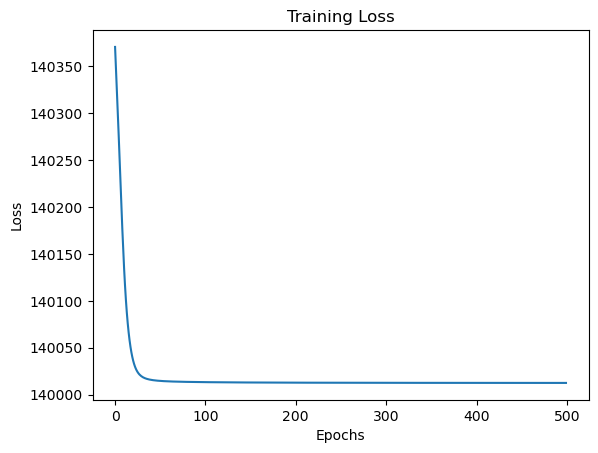

In [8]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Split data into training and testing sets (for simplicity we'll use 80% training, 20% testing)
n_samples = len(Xf)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf[:split_index], Xf[split_index:]
Y_train, Y_test = HXf_t1[:split_index], HXf_t1[split_index:]

# DNN class definition
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super().__init__()
        self.in_dim = in_dim
        self.out_dim = out_dim
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Early stopping and history tracking class
class EarlyStoppingPredictHistory():
    def __init__(self):
        super(EarlyStoppingPredictHistory, self).__init__()
        self.logs = {"loss": []}
        self.best_loss = float('inf')
        self.best_weights = None
        self.stop_training = False

    def on_epoch_end(self, epoch, model, loss):
        current_loss = loss.item()
        self.logs["loss"].append(current_loss)

        if current_loss < self.best_loss:
            self.best_loss = current_loss
            self.best_weights = model.state_dict().copy()
            print(f"Epoch {epoch} - New best loss: {current_loss:.6f}")

        if epoch % 100 == 0:
            print(f"Epoch {epoch} - Loss: {current_loss:.6f}")

    def on_train_end(self, model):
        if self.best_weights is not None:
            model.load_state_dict(self.best_weights)
        print("Training complete. Best loss:", self.best_loss)

# Define the DNN training and testing process
def train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=1000):
    input_dim = X_train.shape[1]  # Number of input parameters (same as the input CSV columns)
    output_dim = Y_train.shape[1]  # Number of output parameters (we have 6 outputs)

    model = DNN(in_dim=input_dim, out_dim=output_dim).double()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    history = EarlyStoppingPredictHistory()

    X_train_tensor = torch.from_numpy(X_train).double()
    Y_train_tensor = torch.from_numpy(Y_train).double()

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()

        outputs = model(X_train_tensor)
        loss = criterion(outputs, Y_train_tensor)

        loss.backward()
        optimizer.step()

        history.on_epoch_end(epoch, model, loss)

        if history.stop_training:
            break

    history.on_train_end(model)

    return model, history

# Train the model
model, history = train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=500)

# Test the model
X_test_tensor = torch.from_numpy(X_test).double()
Y_test_pred = model(X_test_tensor).detach().numpy()

# Compute the error for testing data
test_error = np.mean((Y_test - Y_test_pred) ** 2)
print("Test Error (MSE):", test_error)

# Plot training loss
def plot_loss(history):
    plt.plot(history.logs['loss'])
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(history)


Key Updates:
Data Normalization:

Added StandardScaler to normalize the input and output data, which is important for deep learning models to improve convergence speed and stability

Dropout Layers:

Introduced Dropout(0.2) after each hidden layer in the DNN architecture to prevent overfitting during training

Learning Rate Adjustment:

Changed the learning rate in the Adam optimizer to 1e-4 to make the training more stable

Inverse Transformation:

After testing the model, the predictions are inverse-transformed to return them to the original scale for comparison with the actual values

Error Calculation:

Computed the test error using the Mean Squared Error (MSE) between the predicted and actual outputs

Epoch 0 - New best loss: 0.912099
Epoch 0 - Loss: 0.912099
Epoch 1 - New best loss: 0.907464
Epoch 2 - New best loss: 0.906269
Epoch 3 - New best loss: 0.903981
Epoch 4 - New best loss: 0.902037
Epoch 5 - New best loss: 0.901376
Epoch 8 - New best loss: 0.900163
Epoch 9 - New best loss: 0.898686
Epoch 10 - New best loss: 0.898423
Epoch 11 - New best loss: 0.896256
Epoch 12 - New best loss: 0.895738
Epoch 14 - New best loss: 0.894379
Epoch 16 - New best loss: 0.892812
Epoch 17 - New best loss: 0.889511
Epoch 19 - New best loss: 0.887040
Epoch 21 - New best loss: 0.887017
Epoch 24 - New best loss: 0.885855
Epoch 25 - New best loss: 0.882925
Epoch 26 - New best loss: 0.882147
Epoch 27 - New best loss: 0.879910
Epoch 29 - New best loss: 0.879179
Epoch 30 - New best loss: 0.875884
Epoch 33 - New best loss: 0.875307
Epoch 34 - New best loss: 0.872965
Epoch 38 - New best loss: 0.870173
Epoch 39 - New best loss: 0.867665
Epoch 43 - New best loss: 0.865025
Epoch 44 - New best loss: 0.862175
Epo

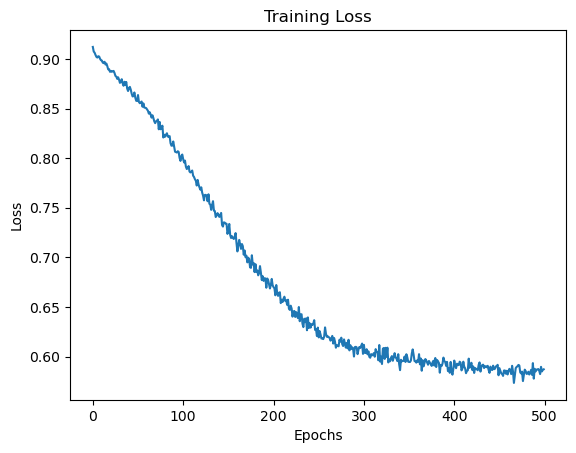

In [9]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# DNN class definition with Dropout to avoid overfitting
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super().__init__()
        self.in_dim = in_dim
        self.out_dim = out_dim
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Dropout(0.2),  # Added Dropout after each hidden layer
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Early stopping and history tracking class
class EarlyStoppingPredictHistory():
    def __init__(self):
        super(EarlyStoppingPredictHistory, self).__init__()
        self.logs = {"loss": []}
        self.best_loss = float('inf')
        self.best_weights = None
        self.stop_training = False

    def on_epoch_end(self, epoch, model, loss):
        current_loss = loss.item()
        self.logs["loss"].append(current_loss)

        if current_loss < self.best_loss:
            self.best_loss = current_loss
            self.best_weights = model.state_dict().copy()
            print(f"Epoch {epoch} - New best loss: {current_loss:.6f}")

        if epoch % 100 == 0:
            print(f"Epoch {epoch} - Loss: {current_loss:.6f}")

    def on_train_end(self, model):
        if self.best_weights is not None:
            model.load_state_dict(self.best_weights)
        print("Training complete. Best loss:", self.best_loss)

# Define the DNN training and testing process
def train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=1000, lr=1e-4):
    input_dim = X_train.shape[1]  # Number of input parameters
    output_dim = Y_train.shape[1]  # Number of output parameters

    model = DNN(in_dim=input_dim, out_dim=output_dim).double()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)  # Adjusted learning rate

    history = EarlyStoppingPredictHistory()

    X_train_tensor = torch.from_numpy(X_train).double()
    Y_train_tensor = torch.from_numpy(Y_train).double()

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()

        outputs = model(X_train_tensor)
        loss = criterion(outputs, Y_train_tensor)

        loss.backward()
        optimizer.step()

        history.on_epoch_end(epoch, model, loss)

        if history.stop_training:
            break

    history.on_train_end(model)

    return model, history

# Train the model with normalized data
model, history = train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=500, lr=1e-4)

# Test the model
X_test_tensor = torch.from_numpy(X_test).double()
Y_test_pred_scaled = model(X_test_tensor).detach().numpy()

# Inverse transform the predictions to return them to the original scale
Y_test_pred = scaler_Y.inverse_transform(Y_test_pred_scaled)
Y_test_actual = scaler_Y.inverse_transform(Y_test)

# Compute the error for testing data
test_error = np.mean((Y_test_actual - Y_test_pred) ** 2)
print("Test Error (MSE):", test_error)

# Plot training loss
def plot_loss(history):
    plt.plot(history.logs['loss'])
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(history)


Changes Made:

L2 Regularization:
In the optimizer, I added weight_decay=1e-5 to incorporate L2 regularization.
This will penalize large weights during training, helping to reduce overfitting.

Dropout:

Dropout is still in place after each hidden layer to prevent overfitting.

Epoch 0 - New best loss: 0.910289
Epoch 0 - Loss: 0.910289
Epoch 1 - New best loss: 0.906929
Epoch 2 - New best loss: 0.906685
Epoch 4 - New best loss: 0.902080
Epoch 6 - New best loss: 0.901271
Epoch 8 - New best loss: 0.900984
Epoch 9 - New best loss: 0.898882
Epoch 10 - New best loss: 0.897917
Epoch 12 - New best loss: 0.897902
Epoch 13 - New best loss: 0.893950
Epoch 16 - New best loss: 0.893706
Epoch 17 - New best loss: 0.889235
Epoch 21 - New best loss: 0.888535
Epoch 24 - New best loss: 0.885199
Epoch 25 - New best loss: 0.885168
Epoch 26 - New best loss: 0.885108
Epoch 27 - New best loss: 0.883067
Epoch 28 - New best loss: 0.881344
Epoch 29 - New best loss: 0.880019
Epoch 30 - New best loss: 0.878067
Epoch 33 - New best loss: 0.877298
Epoch 34 - New best loss: 0.876609
Epoch 35 - New best loss: 0.874674
Epoch 37 - New best loss: 0.873804
Epoch 39 - New best loss: 0.873194
Epoch 40 - New best loss: 0.870486
Epoch 41 - New best loss: 0.867543
Epoch 44 - New best loss: 0.867467
Ep

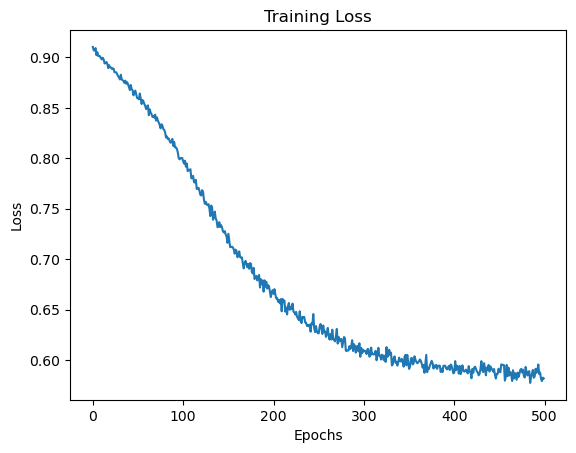

In [10]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# DNN class definition with Dropout to avoid overfitting
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super().__init__()
        self.in_dim = in_dim
        self.out_dim = out_dim
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Dropout(0.2),  # Added Dropout after each hidden layer
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Early stopping and history tracking class
class EarlyStoppingPredictHistory():
    def __init__(self):
        super(EarlyStoppingPredictHistory, self).__init__()
        self.logs = {"loss": []}
        self.best_loss = float('inf')
        self.best_weights = None
        self.stop_training = False

    def on_epoch_end(self, epoch, model, loss):
        current_loss = loss.item()
        self.logs["loss"].append(current_loss)

        if current_loss < self.best_loss:
            self.best_loss = current_loss
            self.best_weights = model.state_dict().copy()
            print(f"Epoch {epoch} - New best loss: {current_loss:.6f}")

        if epoch % 100 == 0:
            print(f"Epoch {epoch} - Loss: {current_loss:.6f}")

    def on_train_end(self, model):
        if self.best_weights is not None:
            model.load_state_dict(self.best_weights)
        print("Training complete. Best loss:", self.best_loss)

# Define the DNN training and testing process
def train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=1000, lr=1e-4):
    input_dim = X_train.shape[1]  # Number of input parameters
    output_dim = Y_train.shape[1]  # Number of output parameters

    model = DNN(in_dim=input_dim, out_dim=output_dim).double()
    criterion = nn.MSELoss()
    
    # Apply weight decay (L2 regularization) in the optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)  # Added weight_decay for L2 regularization

    history = EarlyStoppingPredictHistory()

    X_train_tensor = torch.from_numpy(X_train).double()
    Y_train_tensor = torch.from_numpy(Y_train).double()

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()

        outputs = model(X_train_tensor)
        loss = criterion(outputs, Y_train_tensor)

        loss.backward()
        optimizer.step()

        history.on_epoch_end(epoch, model, loss)

        if history.stop_training:
            break

    history.on_train_end(model)

    return model, history

# Train the model with normalized data and L2 regularization
model, history = train_dnn(X_train, Y_train, X_test, Y_test, n_epochs=500, lr=1e-4)

# Test the model
X_test_tensor = torch.from_numpy(X_test).double()
Y_test_pred_scaled = model(X_test_tensor).detach().numpy()

# Inverse transform the predictions to return them to the original scale
Y_test_pred = scaler_Y.inverse_transform(Y_test_pred_scaled)
Y_test_actual = scaler_Y.inverse_transform(Y_test)

# Compute the error for testing data
test_error = np.mean((Y_test_actual - Y_test_pred) ** 2)
print("Test Error (MSE):", test_error)

# Plot training loss
def plot_loss(history):
    plt.plot(history.logs['loss'])
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(history)


Epoch 0: Loss = 0.9117071021260521
Epoch 100: Loss = 0.7891615342115502
Epoch 200: Loss = 0.6658851519040293
Epoch 300: Loss = 0.6028598339104694
Epoch 400: Loss = 0.5916615220866034
Epoch 500: Loss = 0.5810360707731876
Epoch 600: Loss = 0.5828333040826519
Epoch 700: Loss = 0.578832466807244
Epoch 800: Loss = 0.5771717315164311
Epoch 900: Loss = 0.5714014458849194


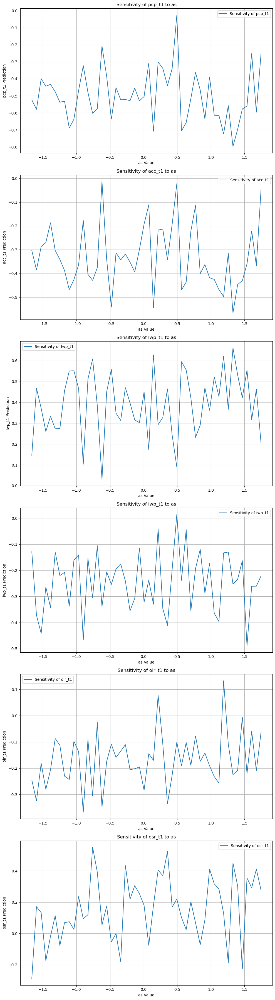

In [11]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Input and output features names
input_features = input_data.columns.tolist()
output_features = ['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']

# Select only the output for the first time step
output_data_t1 = output_data[output_features]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Define the DNN class with dropout layers to avoid overfitting
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super(DNN, self).__init__()
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Train the DNN
def train_dnn(X_train, Y_train, n_epochs=1000, lr=1e-4):
    model = DNN(X_train.shape[1], Y_train.shape[1]).double()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()
        outputs = model(torch.from_numpy(X_train).double())
        loss = criterion(outputs, torch.from_numpy(Y_train).double())
        loss.backward()
        optimizer.step()

        if epoch % 100 == 0:
            print(f'Epoch {epoch}: Loss = {loss.item()}')

    return model

# Train the model
model = train_dnn(X_train, Y_train)

# Function to plot sensitivity of all outputs to one input
def plot_sensitivity_all_outputs_one_input(model, data, input_idx, num_points=50):
    fig, axes = plt.subplots(len(output_features), 1, figsize=(10, 6*len(output_features)))
    min_val, max_val = np.min(data[:, input_idx]), np.max(data[:, input_idx])
    input_values = np.linspace(min_val, max_val, num_points)
    modified_data = np.tile(np.mean(data, axis=0), (num_points, 1))
    modified_data[:, input_idx] = input_values
    predictions = model(torch.from_numpy(modified_data).double()).detach().numpy()

    for i in range(len(output_features)):
        axes[i].plot(input_values, predictions[:, i], label=f'Sensitivity of {output_features[i]}')
        axes[i].set_title(f'Sensitivity of {output_features[i]} to {input_features[input_idx]}')
        axes[i].set_xlabel(f'{input_features[input_idx]} Value')
        axes[i].set_ylabel(f'{output_features[i]} Prediction')
        axes[i].legend()
        axes[i].grid(True)
    plt.tight_layout()
    plt.show()

# Example: Plot sensitivity of all outputs to the first input
plot_sensitivity_all_outputs_one_input(model, X_train, 0)


Epoch 0: Loss = 0.9293353453044597
Epoch 100: Loss = 0.7898890892976527
Epoch 200: Loss = 0.6707797861240468
Epoch 300: Loss = 0.6137336606359405
Epoch 400: Loss = 0.5955747496741395
Epoch 500: Loss = 0.5863155700652245
Epoch 600: Loss = 0.5816670240501484
Epoch 700: Loss = 0.5744953041603398
Epoch 800: Loss = 0.5698871303270509
Epoch 900: Loss = 0.5690430929872399


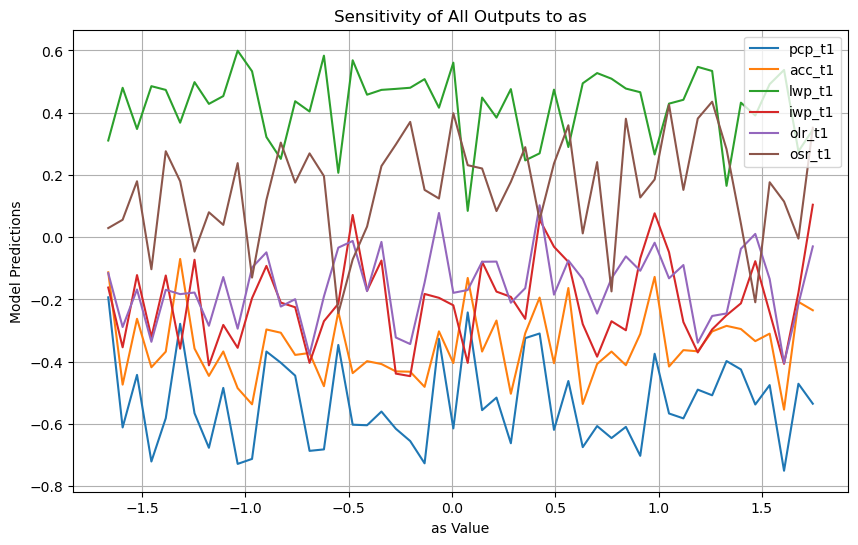

In [12]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Input and output features names
input_features = input_data.columns.tolist()
output_features = ['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']

# Select only the output for the first time step
output_data_t1 = output_data[output_features]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Define the DNN class with dropout layers to avoid overfitting
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super(DNN, self).__init__()
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Train the DNN
def train_dnn(X_train, Y_train, n_epochs=1000, lr=1e-4):
    model = DNN(X_train.shape[1], Y_train.shape[1]).double()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()
        outputs = model(torch.from_numpy(X_train).double())
        loss = criterion(outputs, torch.from_numpy(Y_train).double())
        loss.backward()
        optimizer.step()

        if epoch % 100 == 0:
            print(f'Epoch {epoch}: Loss = {loss.item()}')

    return model

# Train the model
model = train_dnn(X_train, Y_train)

# Function to plot sensitivity of all outputs to one input on the same graph
def plot_sensitivity_all_outputs_one_input(model, data, input_idx, num_points=50):
    plt.figure(figsize=(10, 6))
    min_val, max_val = np.min(data[:, input_idx]), np.max(data[:, input_idx])
    input_values = np.linspace(min_val, max_val, num_points)
    modified_data = np.tile(np.mean(data, axis=0), (num_points, 1))
    modified_data[:, input_idx] = input_values
    predictions = model(torch.from_numpy(modified_data).double()).detach().numpy()

    for i in range(len(output_features)):
        plt.plot(input_values, predictions[:, i], label=f'{output_features[i]}')
    
    plt.title(f'Sensitivity of All Outputs to {input_features[input_idx]}')
    plt.xlabel(f'{input_features[input_idx]} Value')
    plt.ylabel('Model Predictions')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example: Plot sensitivity of all outputs to the first input
plot_sensitivity_all_outputs_one_input(model, X_train, 0)


Epoch 0: Loss = 0.9120813954222133
Epoch 100: Loss = 0.7876826571904831
Epoch 200: Loss = 0.6736078904711545
Epoch 300: Loss = 0.6071396710062744
Epoch 400: Loss = 0.583989030741486
Epoch 500: Loss = 0.5851750846299556
Epoch 600: Loss = 0.5803973283011887
Epoch 700: Loss = 0.5745026399628922
Epoch 800: Loss = 0.56721860215116
Epoch 900: Loss = 0.5680058802255856


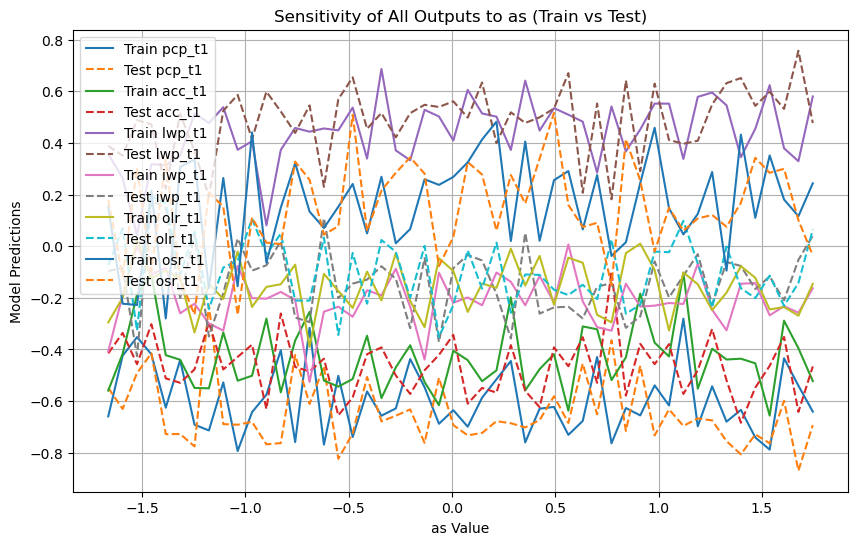

In [13]:
import os
import time
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random as python_random
import gc
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Input and output features names
input_features = input_data.columns.tolist()
output_features = ['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']

# Select only the output for the first time step
output_data_t1 = output_data[output_features]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Define the DNN class with dropout layers to avoid overfitting
class DNN(nn.Module):
    def __init__(self, in_dim, out_dim):
        super(DNN, self).__init__()
        self.lin = nn.Sequential(
            nn.Linear(in_dim, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, 50),
            nn.Tanh(),
            nn.Dropout(0.2),
            nn.Linear(50, out_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.lin(x)

# Train the DNN
def train_dnn(X_train, Y_train, n_epochs=1000, lr=1e-4):
    model = DNN(X_train.shape[1], Y_train.shape[1]).double()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)

    for epoch in range(n_epochs):
        model.train()
        optimizer.zero_grad()
        outputs = model(torch.from_numpy(X_train).double())
        loss = criterion(outputs, torch.from_numpy(Y_train).double())
        loss.backward()
        optimizer.step()

        if epoch % 100 == 0:
            print(f'Epoch {epoch}: Loss = {loss.item()}')

    return model

# Train the model
model = train_dnn(X_train, Y_train)

# Function to plot sensitivity of all outputs to one input on the same graph with test data comparison
def plot_sensitivity_all_outputs_one_input_with_test(model, X_train, X_test, input_idx, num_points=50):
    plt.figure(figsize=(10, 6))
    min_val, max_val = np.min(X_train[:, input_idx]), np.max(X_train[:, input_idx])
    input_values = np.linspace(min_val, max_val, num_points)
    modified_train_data = np.tile(np.mean(X_train, axis=0), (num_points, 1))
    modified_train_data[:, input_idx] = input_values
    modified_test_data = np.tile(np.mean(X_test, axis=0), (num_points, 1))
    modified_test_data[:, input_idx] = input_values

    train_predictions = model(torch.from_numpy(modified_train_data).double()).detach().numpy()
    test_predictions = model(torch.from_numpy(modified_test_data).double()).detach().numpy()

    for i in range(len(output_features)):
        plt.plot(input_values, train_predictions[:, i], label=f'Train {output_features[i]}')
        plt.plot(input_values, test_predictions[:, i], '--', label=f'Test {output_features[i]}')
    
    plt.title(f'Sensitivity of All Outputs to {input_features[input_idx]} (Train vs Test)')
    plt.xlabel(f'{input_features[input_idx]} Value')
    plt.ylabel('Model Predictions')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example: Plot sensitivity of all outputs to the first input including test data
plot_sensitivity_all_outputs_one_input_with_test(model, X_train, X_test, 0)


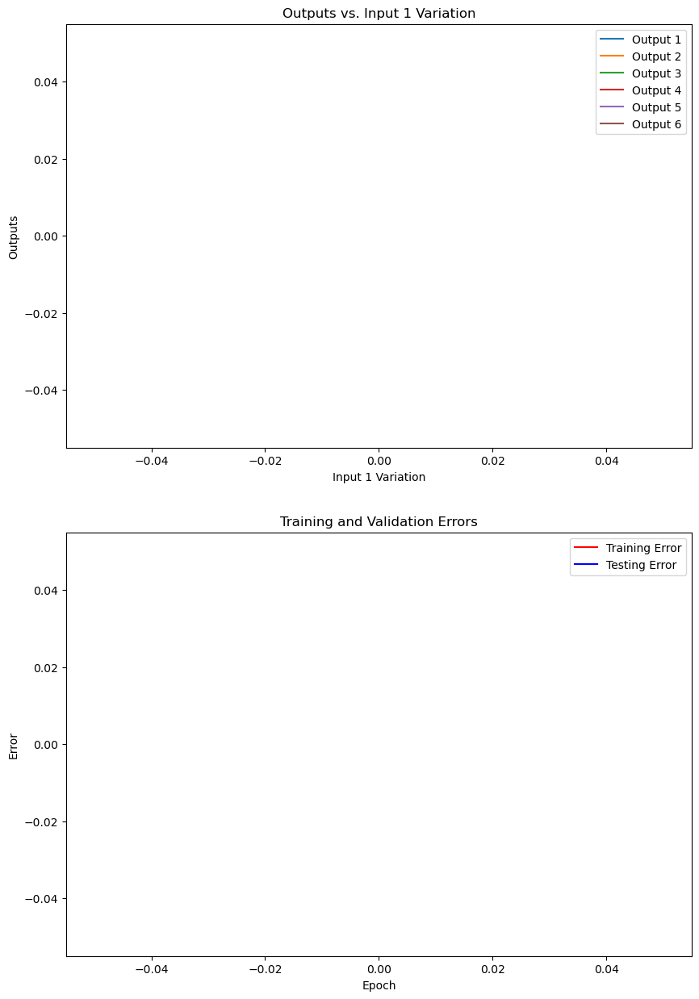

Animation size has reached 21010952 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [14]:
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load data
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

input_data = pd.read_csv(input_csv_path)
output_data = pd.read_csv(output_csv_path)

output_features = ['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']
output_data_t1 = output_data[output_features]

# Data preprocessing
Xf = input_data.values
HXf_t1 = output_data_t1.values

scaler_X = StandardScaler()
scaler_Y = StandardScaler()
Xf_scaled = scaler_X.fit_transform(Xf)
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)

split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Neural network model
class DNN(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(input_dim, 100),
            nn.ReLU(),
            *[nn.Sequential(nn.Linear(100, 100), nn.ReLU()) for _ in range(10)],
            nn.Linear(100, output_dim)
        )

    def forward(self, x):
        return self.layers(x)

model = DNN(X_train.shape[1], Y_train.shape[1])
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

n_epochs = 500
train_errors = []
test_errors = []

# Setup animation
fig, (ax1, ax2) = plt.subplots(2, figsize=(10, 15))

# Plotting setup
lines = [ax1.plot([], [], label=f'Output {i+1}')[0] for i in range(Y_train.shape[1])]
ax1.legend(loc='upper right')
ax1.set_title('Outputs vs. Input 1 Variation')
ax1.set_xlabel('Input 1 Variation')
ax1.set_ylabel('Outputs')

ax2.set_title('Training and Validation Errors')
line2, = ax2.plot([], [], 'r-', label='Training Error')
line3, = ax2.plot([], [], 'b-', label='Testing Error')
ax2.legend()
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Error')

def init():
    for line in lines:
        line.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    return lines + [line2, line3]

def update(epoch):
    # Simulating input variation impact
    x_data = np.linspace(-3, 3, 200)
    test_data = np.repeat(X_test.mean(axis=0)[np.newaxis, :], len(x_data), axis=0)
    test_data[:, 0] = x_data  # Vary the first input feature across its range

    y_data = model(torch.from_numpy(test_data).float()).detach().numpy()
    for i, line in enumerate(lines):
        line.set_data(x_data, y_data[:, i])

    # Calculate and log errors
    train_error = criterion(model(torch.from_numpy(X_train).float()), torch.from_numpy(Y_train).float()).item()
    test_error = criterion(model(torch.from_numpy(X_test).float()), torch.from_numpy(Y_test).float()).item()
    train_errors.append(train_error)
    test_errors.append(test_error)
    
    line2.set_data(np.arange(len(train_errors)), train_errors)
    line3.set_data(np.arange(len(test_errors)), test_errors)
    
    return lines + [line2, line3]

# Running animation
ani = animation.FuncAnimation(fig, update, frames=n_epochs, init_func=init, blit=True, repeat=False)
plt.show()
HTML(ani.to_jshtml())


Data Preprocessing:

The input and output data are loaded from CSV files, scaled using StandardScaler, and split into training and testing sets.

Model Architecture:

A deep neural network (DNN) is defined with multiple layers and Dropout to avoid overfitting. The activation function is Tanh, and Dropout is applied after each hidden layer.

Regularization:

L2 regularization (also called weight decay) is applied in the optimizer (weight_decay=1e-5) to prevent overfitting by penalizing large weights.
Dropout layers help reduce overfitting by randomly setting some of the neurons to zero during training.

Early Stopping:

The model includes early stopping to track the best weights based on the lowest loss observed during training.

Training Process:

The model is trained using the Adam optimizer with an initial learning rate of 1e-4.
Training is stopped if the loss stops improving or after the maximum number of epochs (n_epochs=500).

Error Calculation:

After training, the model is tested on the testing data, and the mean squared error (MSE) is computed to evaluate its performance.

Loss Plotting:

The training loss is plotted after the model finishes training.

Epoch     0: Loss = 5.29061735e-01, Validation Loss = 1.02636361e+00, LR = 9.84913159e-04
Epoch   100: Loss = 2.89015472e-02, Validation Loss = 2.18040034e-01, LR = 2.15373339e-04
Epoch   200: Loss = 3.21685593e-03, Validation Loss = 2.02054545e-01, LR = 4.70962081e-05
Epoch   300: Loss = 1.49709657e-02, Validation Loss = 2.14517638e-01, LR = 1.02986416e-05
Epoch   400: Loss = 9.46077891e-03, Validation Loss = 2.08917886e-01, LR = 2.25202882e-06
Restoring model from memory, best epoch = 494
Final Test Error: 0.210252046585083


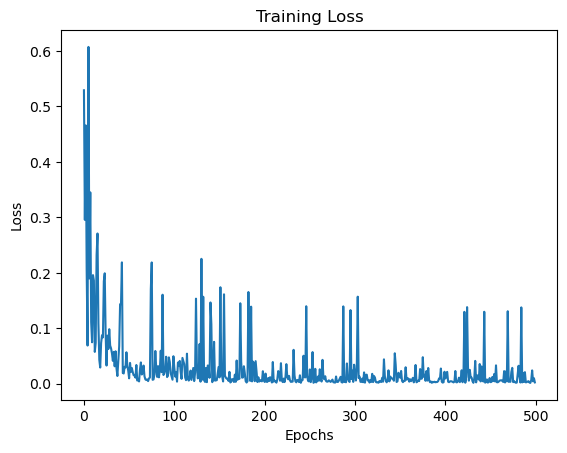

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (200,) and arg 1 with shape (1200,).

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (200,) and arg 1 with shape (1200,).

<Figure size 1200x1000 with 4 Axes>

In [15]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 5000  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred.numpy())
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data)
    line2.set_data(range(len(x_test_data)), model_predictions[n])
    line3.set_data(range(len(x_test_data)), model_predictions[n])
    line4.set_data(range(len(x_test_data)), abs(y_test_data - model_predictions[n]))
    line5.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line6.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test), np.max(Y_test)))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test), np.max(Y_test)))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

txt_title1 = ax1.set_title('True vs Predicted')
txt_title2 = ax2.set_title('Predicted')
txt_title3 = ax3.set_title('Pointwise Absolute Error')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);


anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

HTML(anim.to_html5_video())


In [16]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred.numpy())
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data)
    line2.set_data(range(len(x_test_data)), model_predictions[n])
    line3.set_data(range(len(x_test_data)), model_predictions[n])
    line4.set_data(range(len(x_test_data)), abs(y_test_data - model_predictions[n]))
    line5.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line6.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test), np.max(Y_test)))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test), np.max(Y_test)))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted')
txt_title2 = ax2.set_title('Predicted')
txt_title3 = ax3.set_title('Pointwise Absolute Error')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


Epoch     0: Loss = 1.15597975e+00, Validation Loss = 1.03415155e+00, LR = 9.84913159e-04
Epoch   100: Loss = 1.69348177e-02, Validation Loss = 2.33601794e-01, LR = 2.15373339e-04
Epoch   200: Loss = 4.65180958e-03, Validation Loss = 1.79214701e-01, LR = 4.70962081e-05
Epoch   300: Loss = 1.70482900e-02, Validation Loss = 1.79726377e-01, LR = 1.02986416e-05


KeyboardInterrupt: 

In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred.numpy())
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data)
    line2.set_data(range(len(x_test_data)), model_predictions[n])
    line3.set_data(range(len(x_test_data)), model_predictions[n])
    line4.set_data(range(len(x_test_data)), abs(y_test_data - model_predictions[n]))
    line5.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line6.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test), np.max(Y_test)))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test), np.max(Y_test)))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted')
txt_title2 = ax2.set_title('Predicted')
txt_title3 = ax3.set_title('Pointwise Absolute Error')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Ensure X_test and Y_test are 1D arrays for plotting
X_test_reshaped = X_test.flatten()  # Flatten to 1D if necessary
Y_test_reshaped = Y_test.flatten()

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            y_pred_reshaped = y_pred.flatten().detach().numpy()  # Flatten predictions to match Y_test
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test_reshaped:", X_test_reshaped.shape)
print("Shape of y_pred_reshaped:", y_pred_reshaped.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data)
    line2.set_data(range(len(x_test_data)), model_predictions[n])
    line3.set_data(range(len(x_test_data)), model_predictions[n])
    line4.set_data(range(len(x_test_data)), abs(y_test_data - model_predictions[n]))
    line5.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line6.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test_reshaped)))
ax1.set_ylim((np.min(Y_test_reshaped), np.max(Y_test_reshaped)))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted')

ax2.set_xlim((0, len(X_test_reshaped)))
ax2.set_ylim((np.min(Y_test_reshaped), np.max(Y_test_reshaped)))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only')

ax3.set_xlim((0, len(X_test_reshaped)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted')
txt_title2 = ax2.set_title('Predicted')
txt_title3 = ax3.set_title('Pointwise Absolute Error')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test_reshaped, Y_test_reshaped, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.flatten().detach().numpy()  # Flatten predictions to match Y_test
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test (reshaped):", X_test.flatten().shape)
print("Shape of y_pred (reshaped):", y_pred_reshaped.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data)
    line2.set_data(range(len(x_test_data)), model_predictions[n])
    line3.set_data(range(len(x_test_data)), model_predictions[n])
    line4.set_data(range(len(x_test_data)), abs(y_test_data - model_predictions[n]))
    line5.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line6.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test.flatten())))
ax1.set_ylim((np.min(Y_test.flatten()), np.max(Y_test.flatten())))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted')

ax2.set_xlim((0, len(X_test.flatten())))
ax2.set_ylim((np.min(Y_test.flatten()), np.max(Y_test.flatten())))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only')

ax3.set_xlim((0, len(X_test.flatten())))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted')
txt_title2 = ax2.set_title('Predicted')
txt_title3 = ax3.set_title('Pointwise Absolute Error')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test.flatten(), Y_test.flatten(), predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.detach().numpy()  # Keep 2D structure (200, 6)
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test:", X_test.shape)
print("Shape of y_pred:", y_pred.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    # Plot for first output variable (e.g., pcp)
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # First output variable (e.g., pcp)
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # First output variable prediction
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for first output
    line4.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line5.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))  # For the first output variable
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.detach().numpy()  # Keep 2D structure (200, 6)
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test:", X_test.shape)
print("Shape of y_pred:", y_pred.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    # Plot for first output variable (e.g., pcp)
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # First output variable (e.g., pcp)
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # First output variable prediction
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for first output
    line4.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line5.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))  # For the first output variable
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())

# Now, let's add the animation for the relationship between x1 and output1
# Prepare data for plotting
# Prepare data for plotting
x1_test = X_test[:, 0]  # Select first column for x1

# Create a copy of X_test with all elements except the first column set to their mean
constant_input = np.mean(X_test[:, 1:], axis=0)
constant_X_test = np.copy(X_test)
constant_X_test[:, 1:] = constant_input

# Predict output for x1_test with constant other inputs
y_pred_x1 = model(torch.from_numpy(constant_X_test).float()).detach().numpy()[:, 0]

# Set up the figure for the animation
fig2, ax2 = plt.subplots()

# Initialize the plot
line2, = ax2.plot([], [], 'bo')

# Set the plot limits
ax2.set_xlim(min(x1_test), max(x1_test))
ax2.set_ylim(min(y_pred_x1), max(y_pred_x1))
ax2.set_xlabel('First Input Variable (x1)')
ax2.set_ylabel('Predicted Output (output1)')
ax2.set_title('Relationship between x1 and output1 (Other Inputs Constant)')

# Animation function
def animate2(i):
    line2.set_data(x1_test[:i+1], y_pred_x1[:i+1])
    return line2,

# Create the animation
ani2 = animation.FuncAnimation(fig2, animate2, frames=len(x1_test), interval=100)

# Display the animation
plt.show()

In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            y_pred_reshaped = y_pred.detach().numpy()
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

########################################
### PART 3: Visualizing x1 vs output1 ###
########################################

# Ensure model is in evaluation mode
model.eval()

# Prepare data for plotting
x1_test = X_test[:, 0]  # Select first column for x1

# Create a copy of X_test with all elements except the first column set to their mean
constant_input = np.mean(X_test[:, 1:], axis=0)
constant_X_test = np.copy(X_test)
constant_X_test[:, 1:] = constant_input  # Keep all variables except x1 constant

# Predict output for x1_test with constant other inputs
with torch.no_grad():
    y_pred_x1 = model(torch.from_numpy(constant_X_test).float()).numpy()[:, 0]  # Only the first output variable

# Set up the figure for the animation
fig, ax = plt.subplots(figsize=(8, 6))
line, = ax.plot([], [], 'bo')
ax.set_xlim(np.min(x1_test) - 0.1, np.max(x1_test) + 0.1)
ax.set_ylim(np.min(y_pred_x1) - 0.1, np.max(y_pred_x1) + 0.1)
ax.set_xlabel('First Input Variable (x1)')
ax.set_ylabel('Predicted First Output Variable (output1)')
ax.set_title('Relationship between x1 and output1 (Other Inputs Constant)')

# Initialize the plot line
def init():
    line.set_data([], [])
    return line,

# Animation function to update each frame
def animate(i):
    line.set_data(x1_test[:i+1], y_pred_x1[:i+1])
    return line,

# Create the animation
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(x1_test), interval=100, blit=True)

# Save the animation as a GIF
ani.save('x1_output1_relationship.gif', writer='pillow')

# Display the animation in Jupyter or IPython
# from IPython.display import HTML
# HTML(ani.to_html5_video())

plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
for epoch in range(total_epochs):
    model.train()
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    # Early stopping logic
    if loss.item() < best_loss:
        best_loss = loss.item()
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

# Restore the best model
model = best_model

# Ensure model is in evaluation mode
model.eval()

########################################
### PART 3: Animating each input vs output1 ###
########################################

# Loop over each input variable and create an animation showing its relationship with output1
for input_idx in range(X_test.shape[1]):
    # Prepare data for plotting
    varying_input = X_test[:, input_idx]  # Select the current input column
    
    # Create a copy of X_test with all elements except the current column set to their mean
    constant_input = np.mean(X_test, axis=0)
    constant_X_test = np.tile(constant_input, (len(X_test), 1))  # Duplicate to match X_test size
    constant_X_test[:, input_idx] = varying_input  # Vary only the selected input

    # Predict output for the varying input with constant other inputs
    with torch.no_grad():
        y_pred_output1 = model(torch.from_numpy(constant_X_test).float()).numpy()[:, 0]  # Only the first output variable

    # Set up the figure for the animation
    fig, ax = plt.subplots(figsize=(8, 6))
    line, = ax.plot([], [], 'bo')
    ax.set_xlim(np.min(varying_input) - 0.1, np.max(varying_input) + 0.1)
    ax.set_ylim(np.min(y_pred_output1) - 0.1, np.max(y_pred_output1) + 0.1)
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('Predicted First Output Variable (output1)')
    ax.set_title(f'Relationship between Input {input_idx + 1} and output1 (Other Inputs Constant)')

    # Initialize the plot line
    def init():
        line.set_data([], [])
        return line,

    # Animation function to update each frame
    def animate(i):
        line.set_data(varying_input[:i+1], y_pred_output1[:i+1])
        return line,

    # Create the animation
    ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(varying_input), interval=100, blit=True)

    # Save the animation as a GIF
    ani.save(f'input_{input_idx + 1}_vs_output1_relationship.gif', writer='pillow')

    # Uncomment to display in Jupyter notebook or IPython
    # HTML(ani.to_html5_video())

    plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store losses for visualization
training_losses = []
test_losses = []

for epoch in range(total_epochs):
    model.train()
    epoch_training_loss = 0.0  # Initialize epoch training loss

    # Training loop
    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        
        # Accumulate training loss
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate and store the mean training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every test_interval epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}')
        model.train()  # Set model back to training mode

# Restore the best model
model = best_model

# Final evaluation on test set
model.eval()
with torch.no_grad():
    y_test_pred = model(torch.from_numpy(X_test).float())
    final_test_loss = criterion(y_test_pred, torch.from_numpy(Y_test).float()).item()
    print(f'Final Test Loss (MSE): {final_test_loss:.6f}')

# Visualize Training and Test Loss
plt.figure(figsize=(10, 5))
plt.plot(range(len(training_losses)), training_losses, label='Training Loss')
plt.plot(range(0, len(training_losses), test_interval), test_losses, label='Test Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Test Loss Over Epochs')
plt.legend()
plt.show()

########################################
### PART 3: Animating each input vs output1 ###
########################################

# Loop over each input variable and create an animation showing its relationship with output1
for input_idx in range(X_test.shape[1]):
    # Prepare data for plotting
    varying_input = X_test[:, input_idx]  # Select the current input column
    
    # Create a copy of X_test with all elements except the current column set to their mean
    constant_input = np.mean(X_test, axis=0)
    constant_X_test = np.tile(constant_input, (len(X_test), 1))  # Duplicate to match X_test size
    constant_X_test[:, input_idx] = varying_input  # Vary only the selected input

    # Predict output for the varying input with constant other inputs
    with torch.no_grad():
        y_pred_output1 = model(torch.from_numpy(constant_X_test).float()).numpy()[:, 0]  # Only the first output variable

    # Set up the figure for the animation
    fig, ax = plt.subplots(figsize=(8, 6))
    line, = ax.plot([], [], 'bo')
    ax.set_xlim(np.min(varying_input) - 0.1, np.max(varying_input) + 0.1)
    ax.set_ylim(np.min(y_pred_output1) - 0.1, np.max(y_pred_output1) + 0.1)
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('Predicted First Output Variable (output1)')
    ax.set_title(f'Relationship between Input {input_idx + 1} and output1 (Other Inputs Constant)')

    # Initialize the plot line
    def init():
        line.set_data([], [])
        return line,

    # Animation function to update each frame
    def animate(i):
        line.set_data(varying_input[:i+1], y_pred_output1[:i+1])
        return line,

    # Create the animation
    ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(varying_input), interval=100, blit=True)

    # Save the animation in multiple formats
    gif_path = f'input_{input_idx + 1}_vs_output1_relationship.gif'
    mp4_path = f'input_{input_idx + 1}_vs_output1_relationship.mp4'
    ani.save(gif_path, writer='pillow')
    ani.save(mp4_path, writer='ffmpeg', fps=10)

    # Display the animation if in a Jupyter notebook environment
    display(HTML(ani.to_jshtml()))  # Display directly in Jupyter (if running in that environment)

    plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store losses for visualization
training_losses = []
test_losses = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}')

# Restore the best model
model = best_model

# Plot training and test loss over epochs
plt.figure(figsize=(10, 5))
plt.plot(range(len(training_losses)), training_losses, label='Training Loss')
plt.plot(test_epochs, test_losses, label='Test Loss', marker='o')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Test Loss Over Epochs')
plt.legend()
plt.show()

###########################################
### PART 3: Animated Sensitivity Analysis ###
###########################################

# Define range for each input feature individually
input_ranges = {}
for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])  # Mean for the specific column
    input_std = np.std(X_test[:, i])    # Std dev for the specific column
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)  # Adjusted for each input

# Perform sensitivity analysis and animate
for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    output_changes = []
    
    # Set up figure and axis for the animation
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_ylim(-2, 2)  # Adjust according to your output scaling
    ax.set_xlabel(f'Input Variable {input_idx + 1} Value')
    ax.set_ylabel('Predicted First Output Variable (output1)')
    ax.set_title(f'Sensitivity of Output 1 to Input {input_idx + 1}')
    line, = ax.plot([], [], 'b-', label=f'Output sensitivity to Input {input_idx + 1}')
    ax.legend()

    # Animation init function
    def init():
        line.set_data([], [])
        return line,

    # Animation update function
    def animate(i):
        # Vary the target input feature and hold others constant
        value = input_ranges[input_idx][i]
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        # Predict the output for the current value of the input feature
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]  # First output variable
            output_changes.append(output)
        
        # Update line data
        line.set_data(input_ranges[input_idx][:i+1], output_changes[:i+1])
        return line,

    # Create the animation for sensitivity analysis
    ani = animation.FuncAnimation(
        fig, animate, init_func=init, 
        frames=len(input_ranges[input_idx]), 
        interval=200,  # Slower frame rate for reduced file size
        blit=True
    )
    
    # Save the animation as GIF and MP4
    ani.save(f'sensitivity_input_{input_idx + 1}.gif', writer='pillow')
    ani.save(f'sensitivity_input_{input_idx + 1}.mp4', writer='ffmpeg', fps=5)

    # Display the animation in Jupyter notebook if needed
    display(HTML(ani.to_jshtml()))
    plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store losses for visualization
training_losses = []
test_losses = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}')

# Restore the best model
model = best_model

###########################################
### PART 3: Plotting Predicted vs Actual ###
###########################################

# Define range for each input feature individually
input_ranges = {}
for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])  # Mean for the specific column
    input_std = np.std(X_test[:, i])    # Std dev for the specific column
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)  # Adjusted for each input

# Plot predicted vs actual output for each input variable
for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    
    # Vary the target input feature and predict outputs
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        # Predict the output for the current value of the input feature
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]  # First output variable
            predicted_outputs.append(output)
    
    # Actual values for comparison
    actual_outputs = Y_test[:, 0]  # First output variable (same for comparison)

    # Plot predicted vs actual output
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()


Epoch 100/500, Training Loss: 0.028448, Test Loss: 0.210153, Learning Rate: 0.000222
Epoch 200/500, Training Loss: 0.018707, Test Loss: 0.200254, Learning Rate: 0.000049
Epoch 300/500, Training Loss: 0.016727, Test Loss: 0.195812, Learning Rate: 0.000011
Epoch 400/500, Training Loss: 0.016138, Test Loss: 0.195139, Learning Rate: 0.000002
Epoch 500/500, Training Loss: 0.015973, Test Loss: 0.194854, Learning Rate: 0.000001


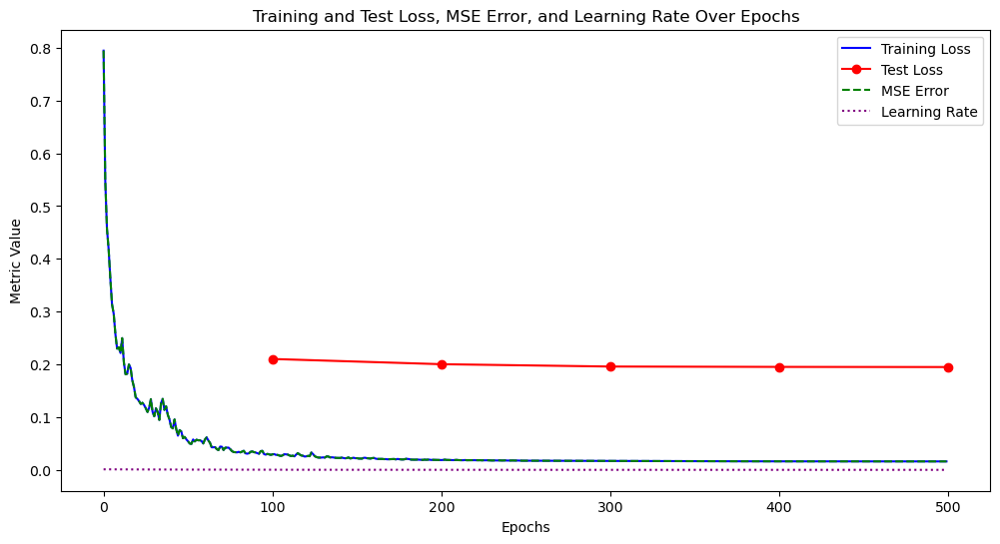

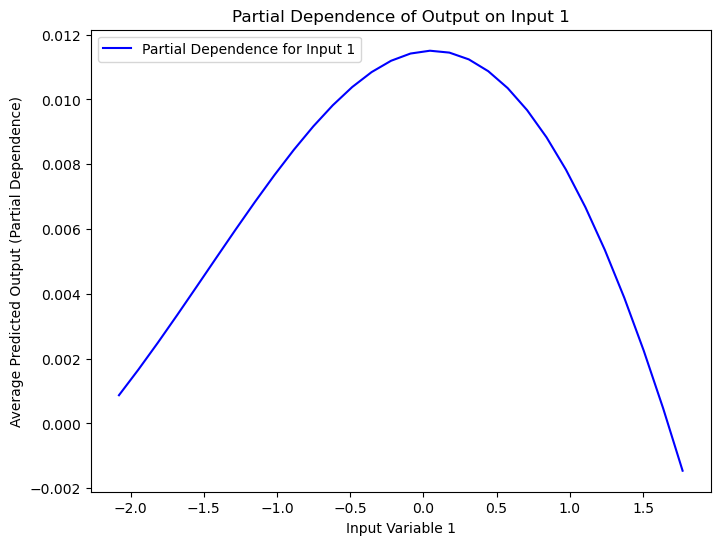

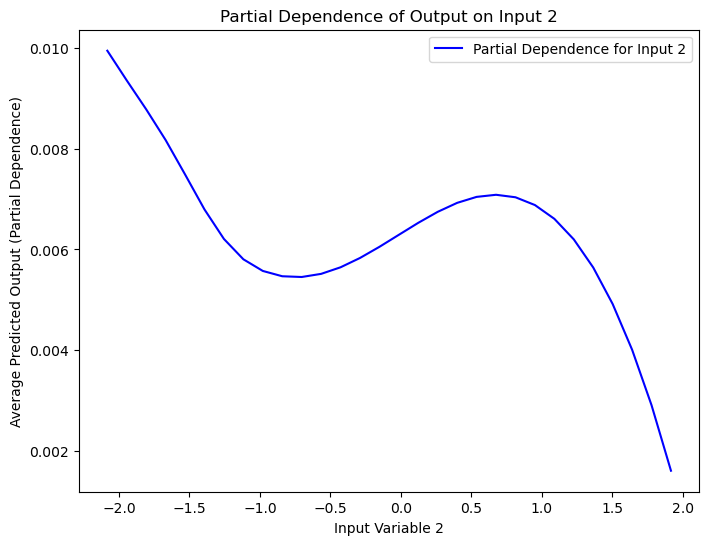

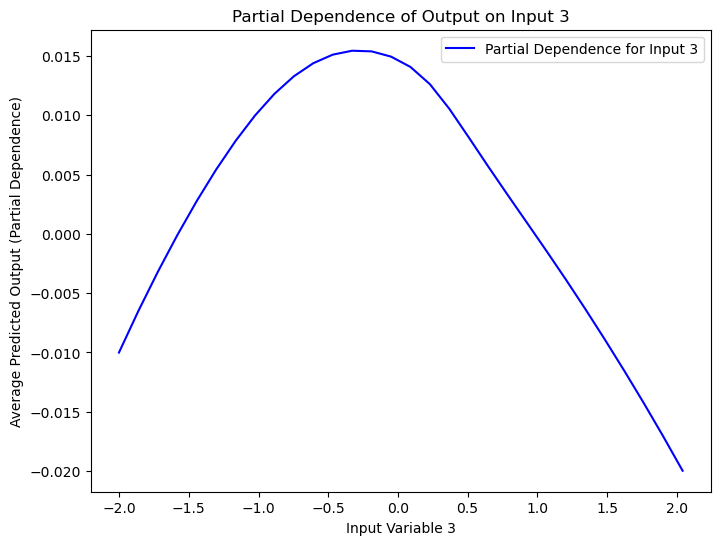

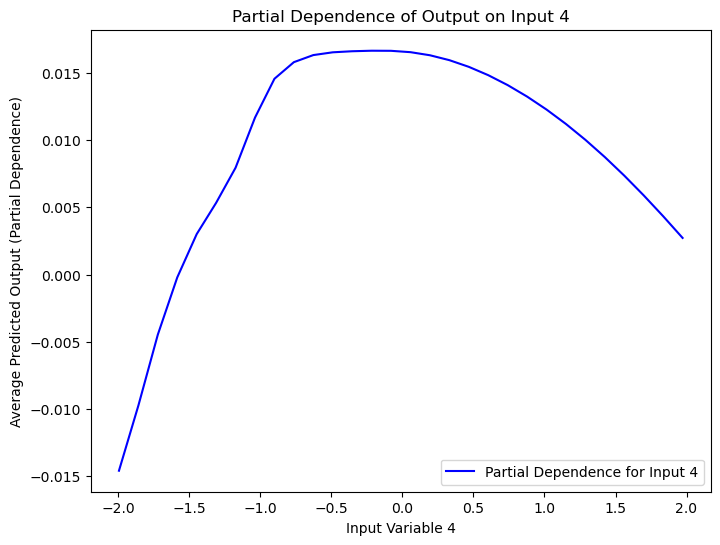

...

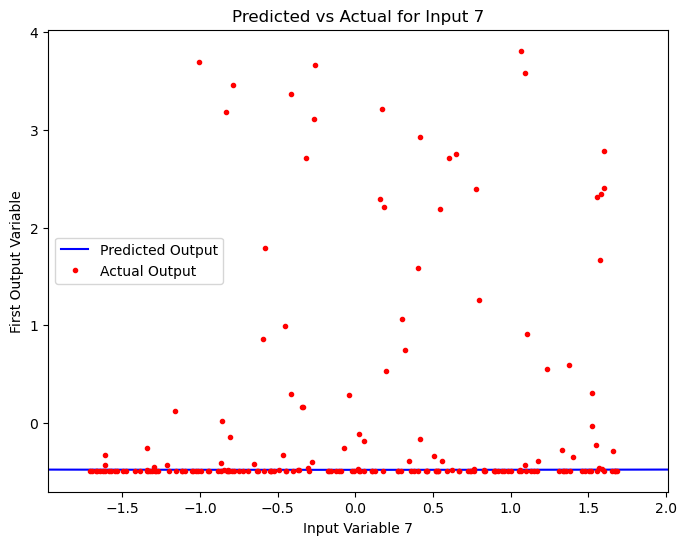

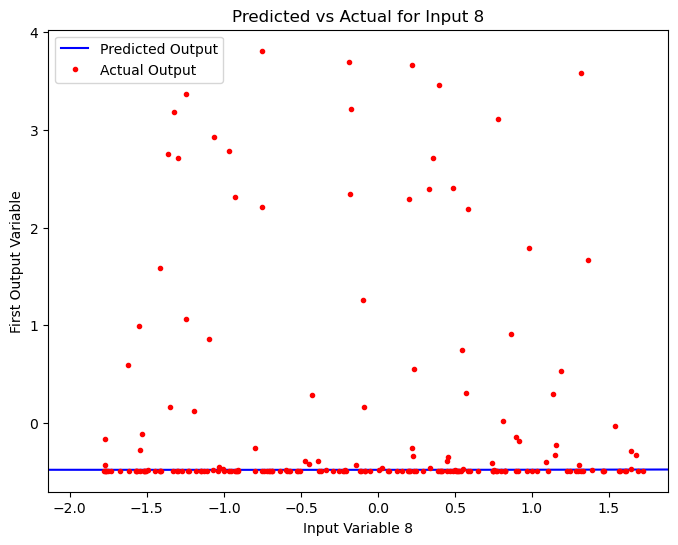

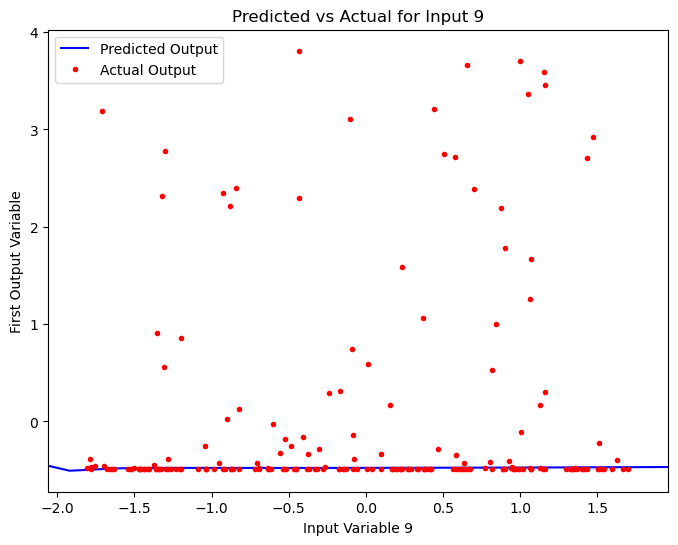

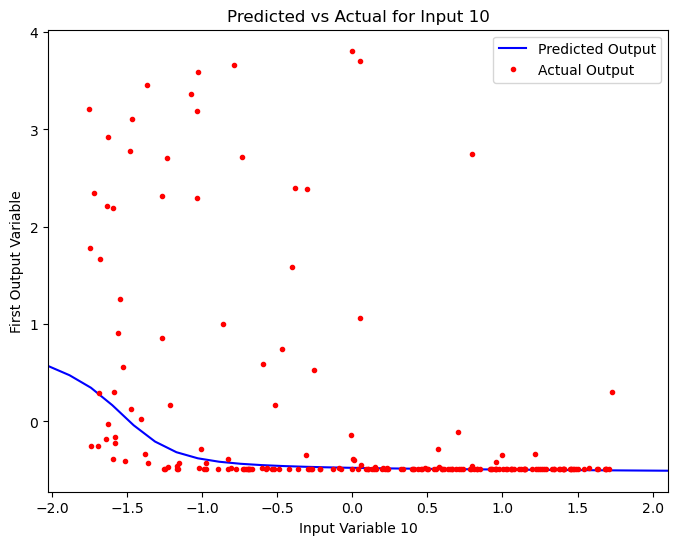

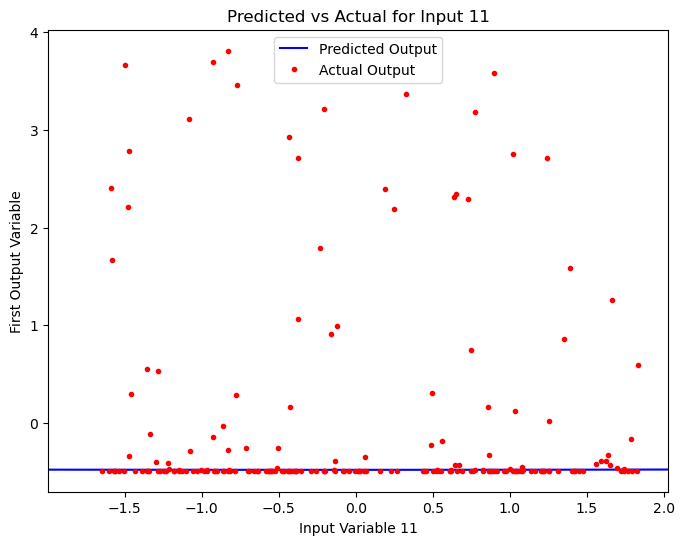

In [17]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(error_tol / init_rate) ** (1 / total_epochs))  # Learning rate decay

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # MSE for the epoch on training data
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

# Plot training loss, test loss, MSE, and learning rate over epochs
plt.figure(figsize=(12, 6))
plt.plot(range(len(training_losses)), training_losses, label='Training Loss', color='blue')
plt.plot(test_epochs, test_losses, label='Test Loss', color='red', marker='o')
plt.plot(range(len(mse_errors)), mse_errors, label='MSE Error', color='green', linestyle='--')
plt.plot(range(len(learning_rates)), learning_rates, label='Learning Rate', color='purple', linestyle=':')
plt.xlabel('Epochs')
plt.ylabel('Metric Value')
plt.title('Training and Test Loss, MSE Error, and Learning Rate Over Epochs')
plt.legend()
plt.show()

###########################################
### PART 3: Partial Dependence Analysis ###
###########################################

# Define range for each input feature individually
input_ranges = {}
partial_dependence_results = {}

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])  # Mean for the specific column
    input_std = np.std(X_test[:, i])    # Std dev for the specific column
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)  # Adjusted for each input

    # Partial dependence calculation
    average_predictions = []
    for value in input_ranges[i]:
        # Create a modified test set where the ith feature is set to the current value across all samples
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        # Predict using the modified test set
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]  # Only the first output variable
            
        # Average predictions across all samples for the current input value
        average_predictions.append(np.mean(predictions))
    
    # Store results for the current input
    partial_dependence_results[i] = (input_ranges[i], average_predictions)

    # Plot partial dependence for the input variable
    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual Plot ###
###########################################

# Plot predicted vs actual output for each input variable
for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    
    # Vary the target input feature and predict outputs
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        # Predict the output for the current value of the input feature
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]  # First output variable
            predicted_outputs.append(output)
    
    # Actual values for comparison
    actual_outputs = Y_test[:, 0]  # First output variable (same for comparison)

    # Plot predicted vs actual output
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()


Sensitivity Analysis through Partial Dependence Plots
Define Range for Each Input Variable:

For each input variable, a range is created (mean ± 2 standard deviations) to systematically vary that input over plausible values.
Partial Dependence Calculation:

For each value in this range:
A modified test set (X_temp) is created where the target input is set to the current value across all samples.
The model predicts the output using this modified dataset, and the predictions are averaged over all samples. This provides a partial dependence estimate.
The averaged output predictions are stored in partial_dependence_results.
Plotting:

For each input, a plot is generated showing the average predicted output as the input variable varies. This shows how sensitive the model’s output is to each input independently.
Sensitivity Analysis in the Form of Predicted vs Actual Plots
In addition to partial dependence, the section PART 4: Predicted vs Actual Plot provides a more direct predicted vs. actual comparison for each input variable. Here:

The code varies each input variable individually while holding others constant and plots both the predicted output and actual observed output values.
This comparison can help visually assess the accuracy of the model’s predictions with respect to each input variable.
Why These Methods Constitute Sensitivity Analysis
Partial Dependence (Global Sensitivity):

Provides insight into the average effect of each input on the output, making it a type of global sensitivity analysis.
Predicted vs. Actual (Model Validation):

The predicted vs. actual plots offer local sensitivity insights by showing how the model reacts to input changes relative to observed values.

Epoch 1000/5000, Training Loss: 0.000276, Test Loss: 0.305747, Learning Rate: 0.000219
Epoch 2000/5000, Training Loss: 0.000063, Test Loss: 0.329615, Learning Rate: 0.000048
Epoch 3000/5000, Training Loss: 0.000024, Test Loss: 0.334627, Learning Rate: 0.000010
Epoch 4000/5000, Training Loss: 0.000019, Test Loss: 0.338603, Learning Rate: 0.000002
Epoch 5000/5000, Training Loss: 0.000018, Test Loss: 0.340171, Learning Rate: 0.000001


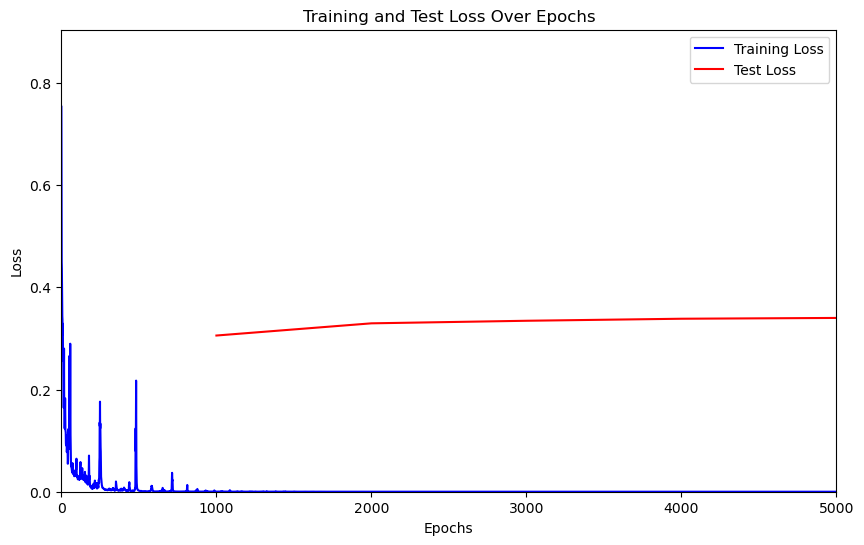

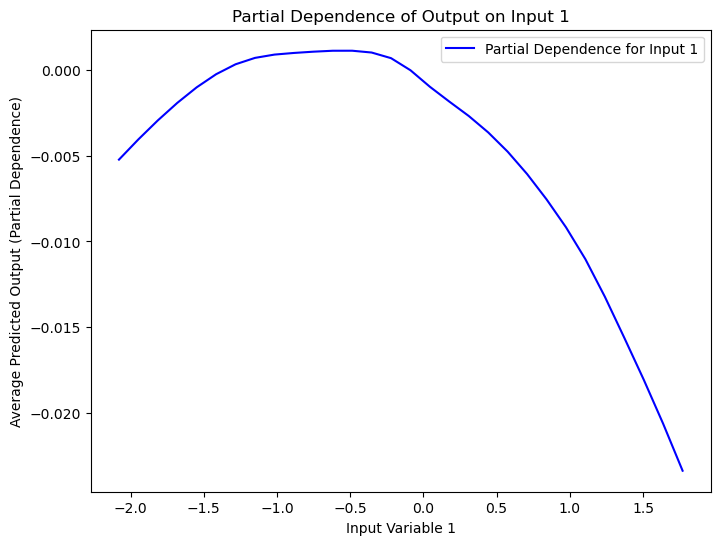

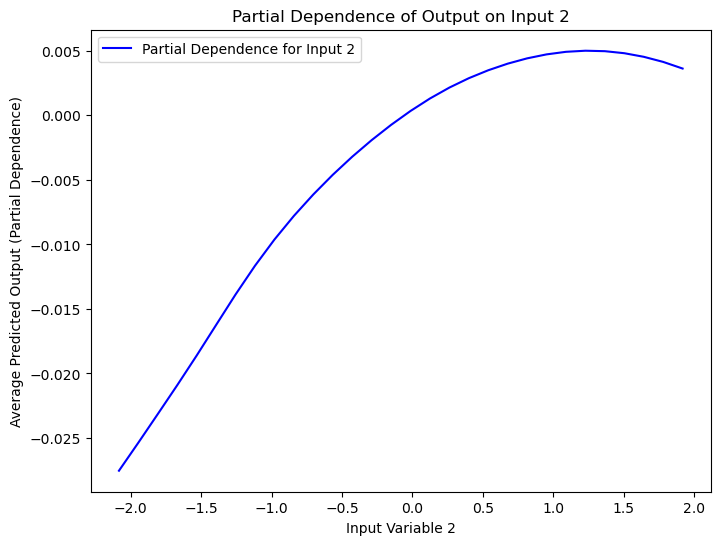

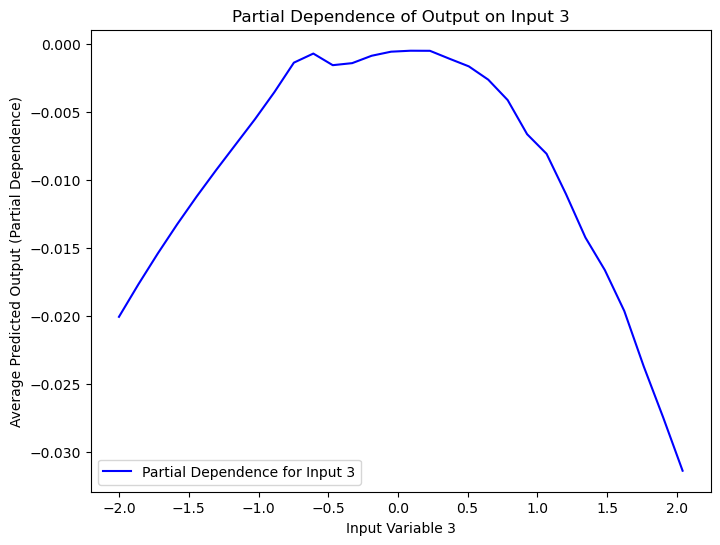

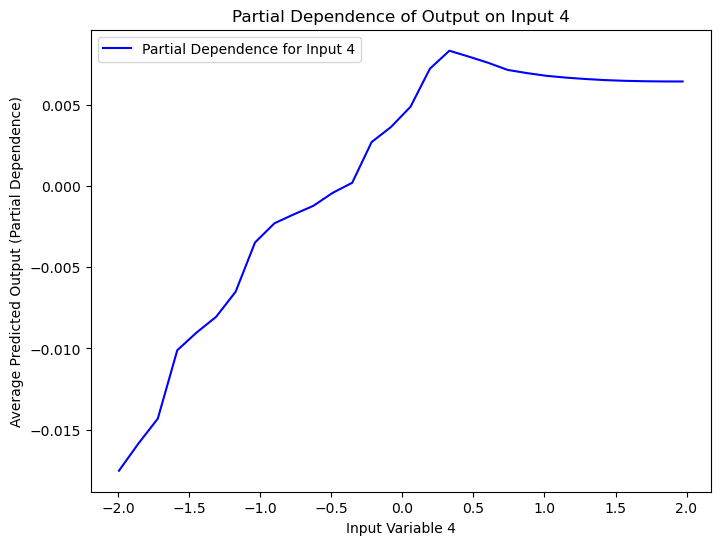

...

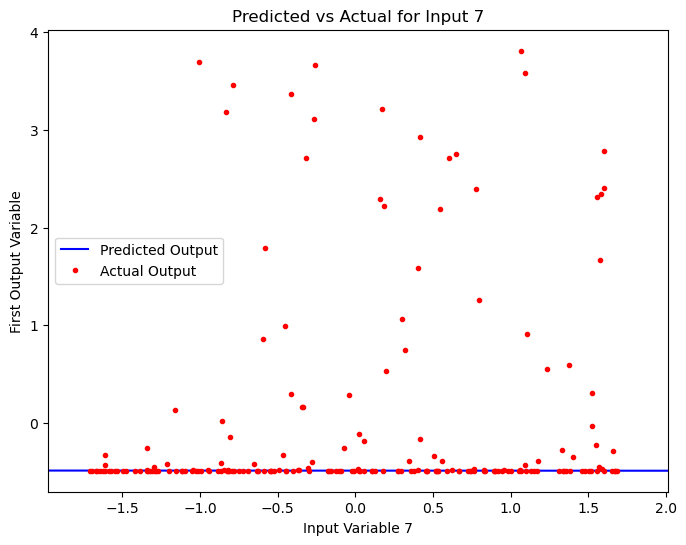

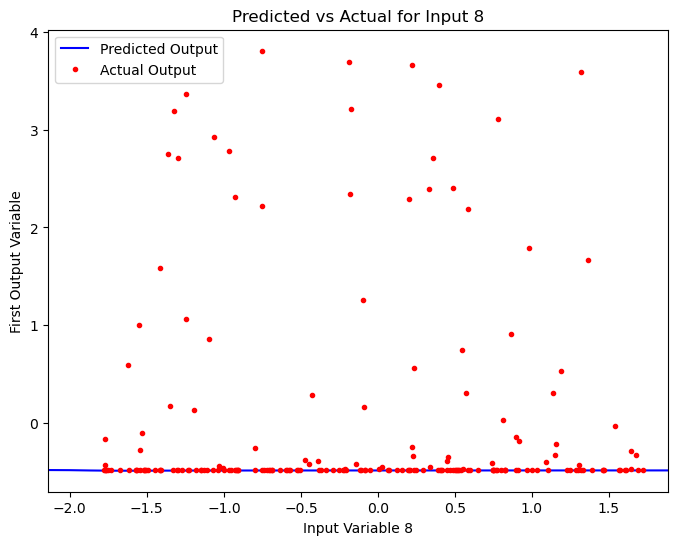

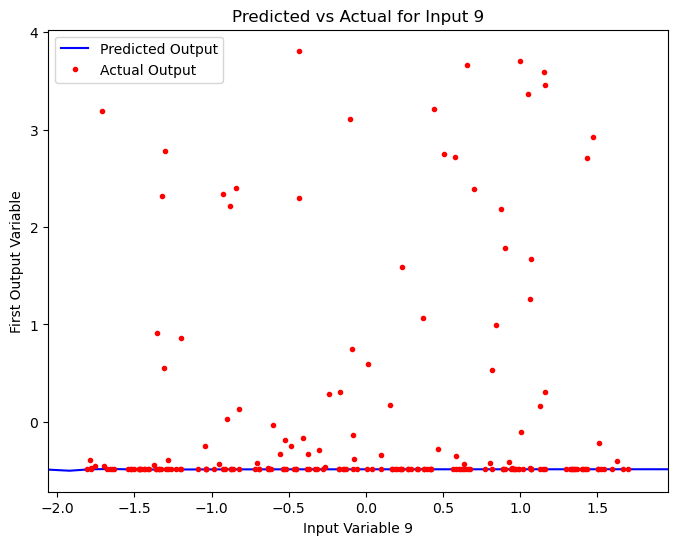

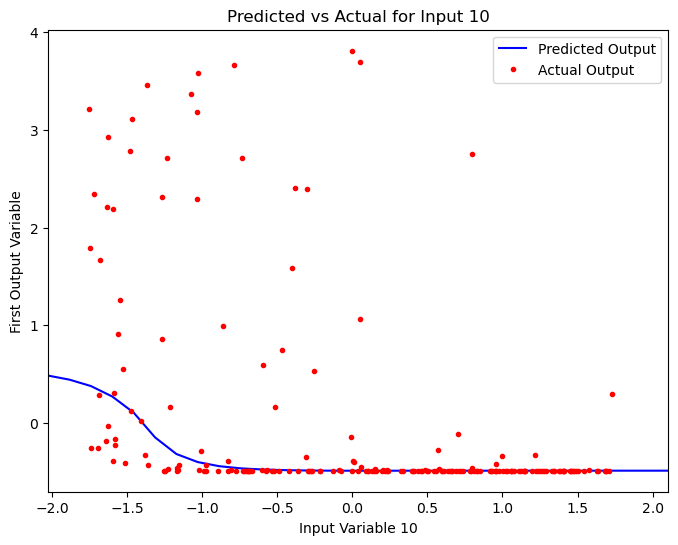

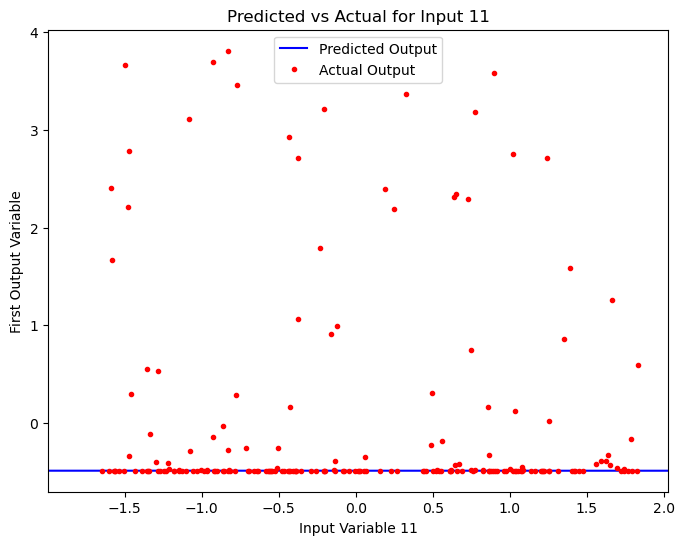

In [18]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 1000
layers = 10
nodes_per_layer = 100
total_epochs = 5000
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(5e-7 / init_rate) ** (1 / total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Track MSE and learning rate
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 2: Animated Training and Test Loss Plot ###
###########################################

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, total_epochs)
ax.set_ylim(0, max(training_losses) * 1.2)
ax.set_xlabel('Epochs')
ax.set_ylabel('Loss')
ax.set_title('Training and Test Loss Over Epochs')

train_line, = ax.plot([], [], 'b-', label='Training Loss')
test_line, = ax.plot([], [], 'r-', label='Test Loss')
ax.legend()

# Initialization function for animation
def init():
    train_line.set_data([], [])
    test_line.set_data([], [])
    return train_line, test_line

# Update function for animation
def update(epoch):
    train_line.set_data(range(epoch + 1), training_losses[:epoch + 1])
    if (epoch + 1) in test_epochs:
        index = test_epochs.index(epoch + 1)
        test_line.set_data(test_epochs[:index + 1], test_losses[:index + 1])

    return train_line, test_line

loss_animation = animation.FuncAnimation(fig, update, init_func=init, frames=total_epochs, interval=50, blit=True)
loss_animation.save('training_test_loss_animation.gif', writer='pillow')
plt.show()

###########################################
### PART 3: Partial Dependence Analysis ###
###########################################

input_ranges = {}
partial_dependence_results = {}

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)

    average_predictions = []
    for value in input_ranges[i]:
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]
            
        average_predictions.append(np.mean(predictions))
    
    partial_dependence_results[i] = (input_ranges[i], average_predictions)

    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual Plot ###
###########################################

for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]
            predicted_outputs.append(output)
    
    actual_outputs = Y_test[:, 0]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()



Epoch 100/500, Training Loss: 0.027157, Test Loss: 0.211606, Learning Rate: 0.000222
Epoch 200/500, Training Loss: 0.018654, Test Loss: 0.207187, Learning Rate: 0.000049
Epoch 300/500, Training Loss: 0.016734, Test Loss: 0.209431, Learning Rate: 0.000011
Epoch 400/500, Training Loss: 0.016212, Test Loss: 0.208842, Learning Rate: 0.000002
Epoch 500/500, Training Loss: 0.016086, Test Loss: 0.208796, Learning Rate: 0.000001


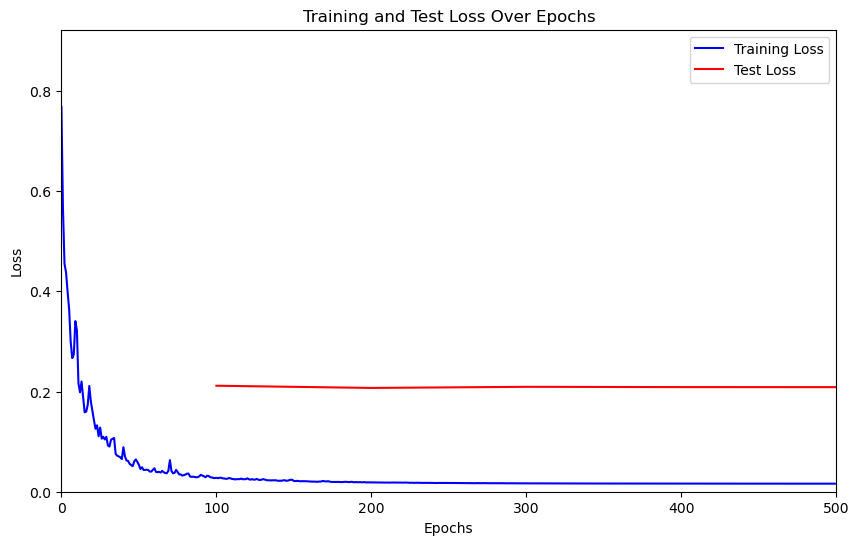

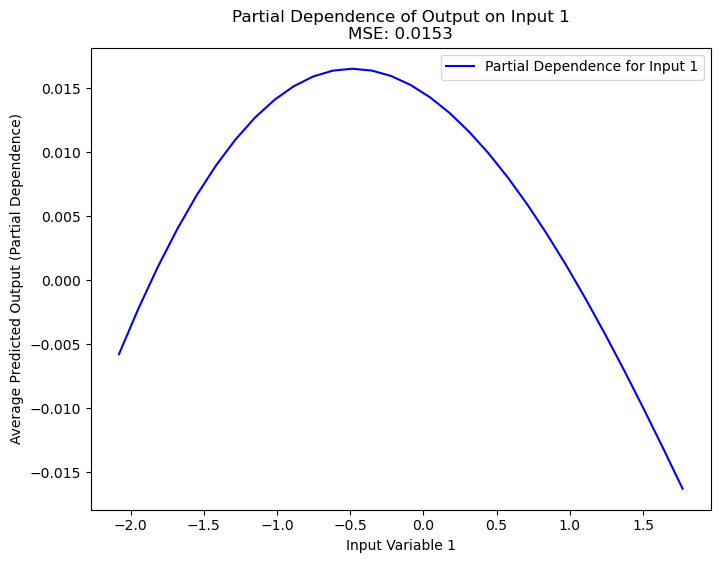

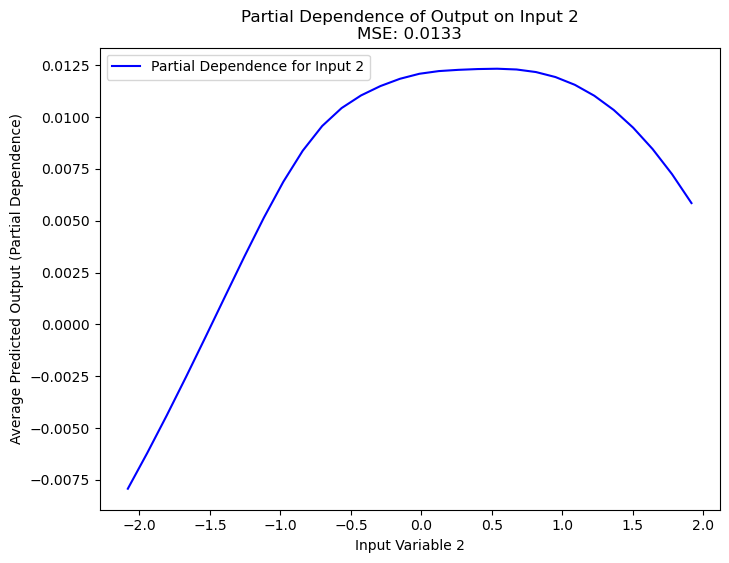

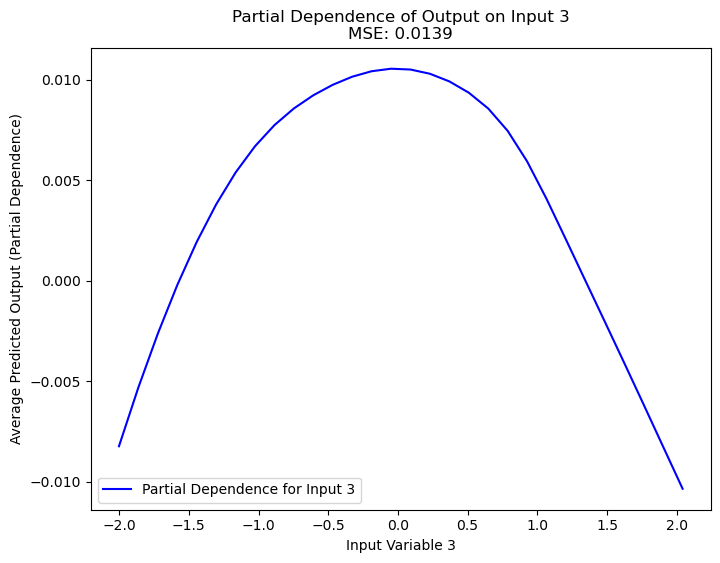

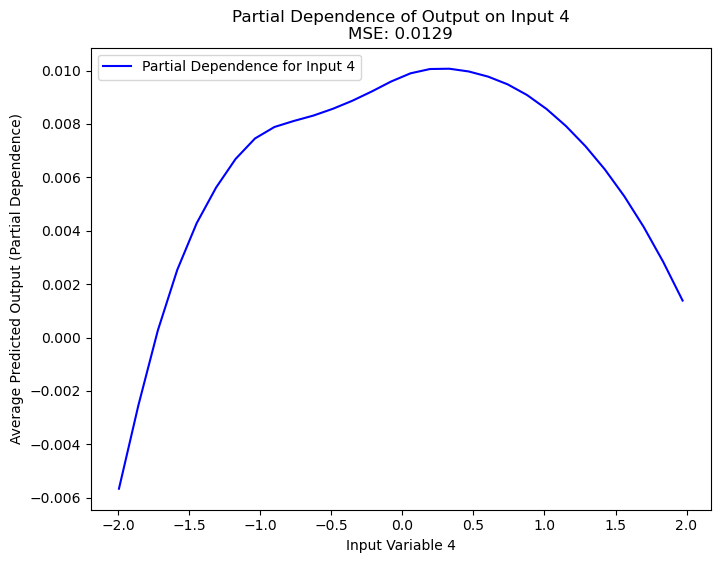

...

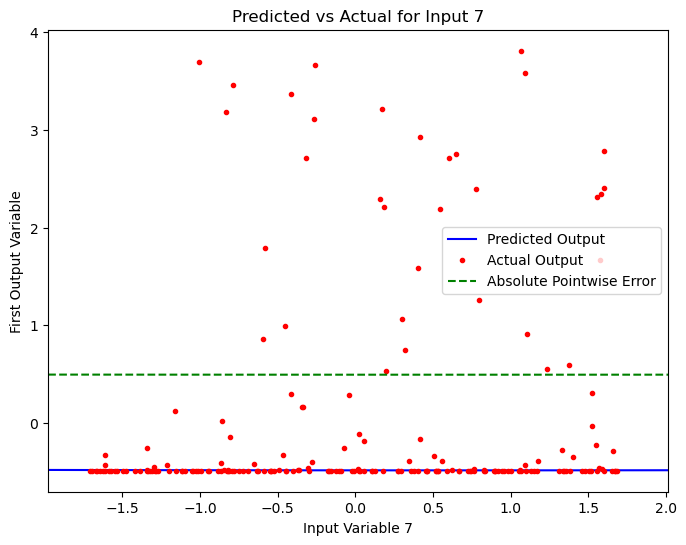

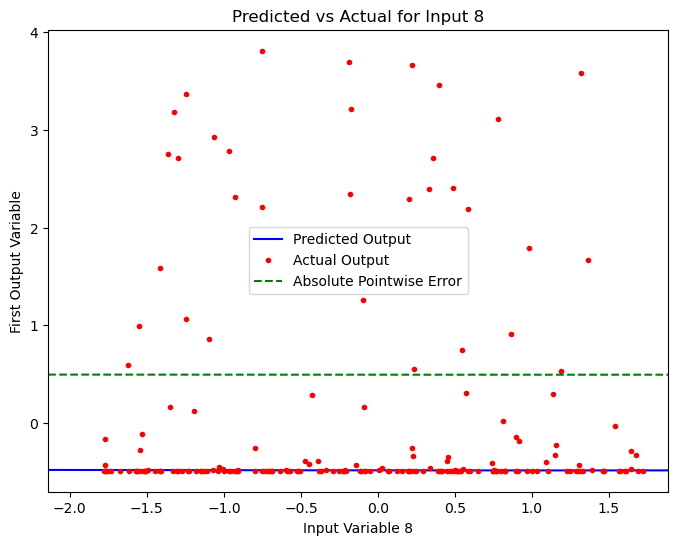

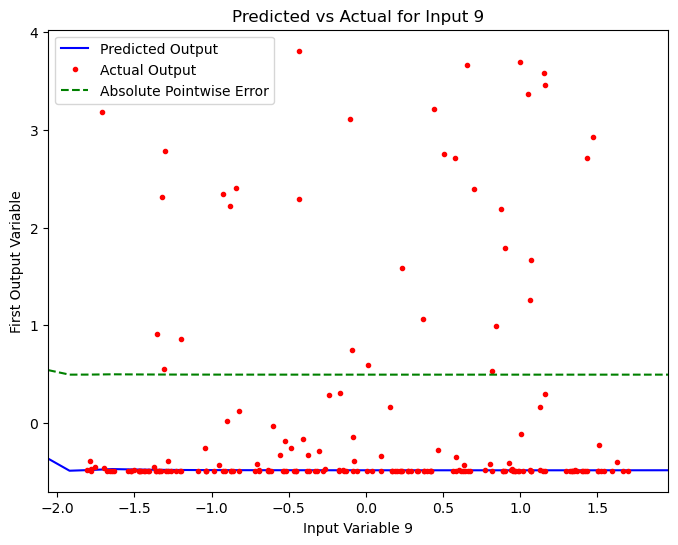

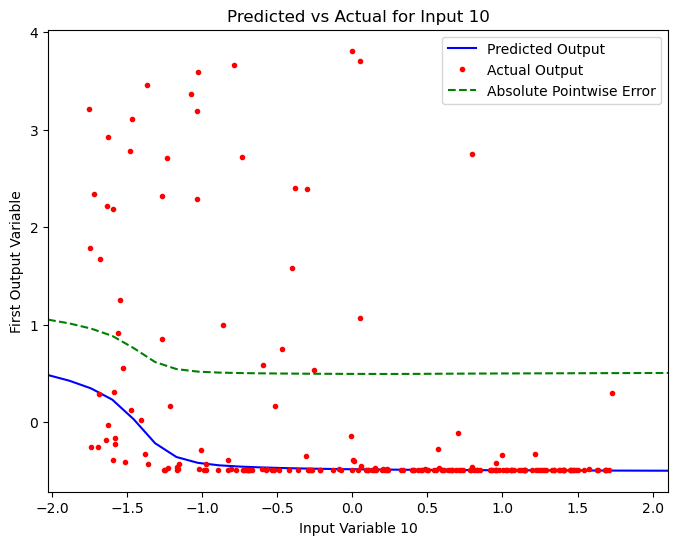

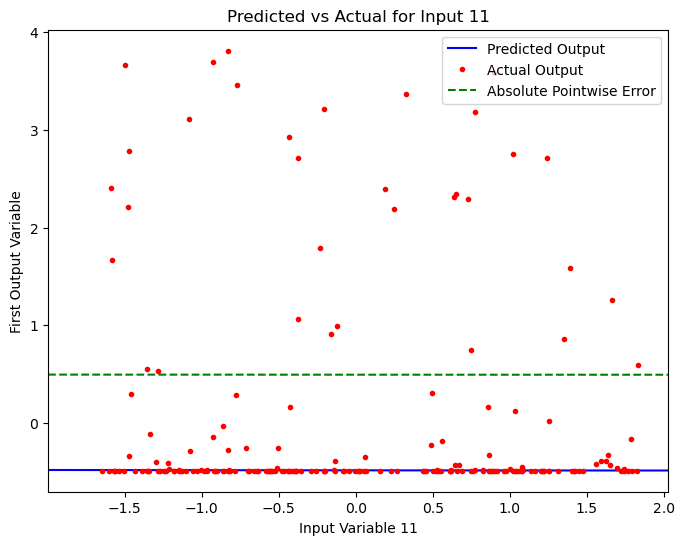

In [19]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(5e-7 / init_rate) ** (1 / total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Track MSE and learning rate
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 2: Animated Training and Test Loss Plot ###
###########################################

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, total_epochs)
ax.set_ylim(0, max(training_losses) * 1.2)
ax.set_xlabel('Epochs')
ax.set_ylabel('Loss')
ax.set_title('Training and Test Loss Over Epochs')

train_line, = ax.plot([], [], 'b-', label='Training Loss')
test_line, = ax.plot([], [], 'r-', label='Test Loss')
ax.legend()

def init():
    train_line.set_data([], [])
    test_line.set_data([], [])
    return train_line, test_line

def update(epoch):
    train_line.set_data(range(epoch + 1), training_losses[:epoch + 1])
    if (epoch + 1) in test_epochs:
        index = test_epochs.index(epoch + 1)
        test_line.set_data(test_epochs[:index + 1], test_losses[:index + 1])

    return train_line, test_line

loss_animation = animation.FuncAnimation(fig, update, init_func=init, frames=total_epochs, interval=50, blit=True)
loss_animation.save('training_test_loss_animation.gif', writer='pillow')
plt.show()

###########################################
### PART 3: Partial Dependence and MSE Analysis ###
###########################################

input_ranges = {}
partial_dependence_results = {}
mse_partial_dependence = []

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)

    average_predictions = []
    mse_errors_for_input = []

    for value in input_ranges[i]:
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]
            
        average_predictions.append(np.mean(predictions))

        # Calculate MSE for current input setting
        mse_errors_for_input.append(((predictions - Y_test[:, 0]) ** 2).mean())

    partial_dependence_results[i] = (input_ranges[i], average_predictions)
    mse_partial_dependence.append(np.mean(mse_errors_for_input))

    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}\nMSE: {mse_partial_dependence[-1]:.4f}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual with Pointwise Error ###
###########################################

for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    pointwise_errors = []
    
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]
            predicted_outputs.append(output)
        
        # Calculate absolute pointwise error
        pointwise_errors.append(abs(output - Y_test[:, 0]).mean())

    actual_outputs = Y_test[:, 0]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.plot(input_ranges[input_idx], pointwise_errors, 'g--', label='Absolute Pointwise Error')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()


Epoch 1000/5000, Training Loss: 0.000267, Test Loss: 0.272189, Learning Rate: 0.000219
Epoch 2000/5000, Training Loss: 0.000033, Test Loss: 0.293762, Learning Rate: 0.000048
Epoch 3000/5000, Training Loss: 0.000016, Test Loss: 0.296581, Learning Rate: 0.000010
Epoch 4000/5000, Training Loss: 0.000011, Test Loss: 0.296169, Learning Rate: 0.000002
Epoch 5000/5000, Training Loss: 0.000010, Test Loss: 0.295699, Learning Rate: 0.000001


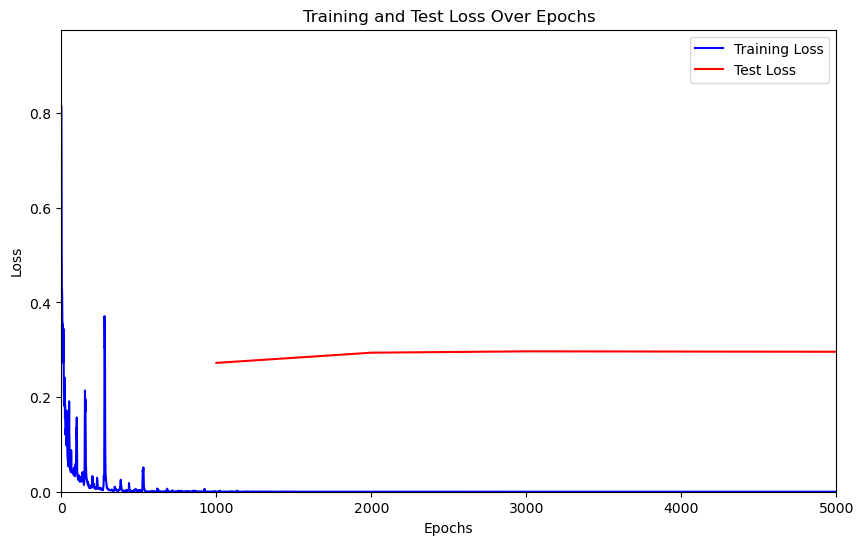

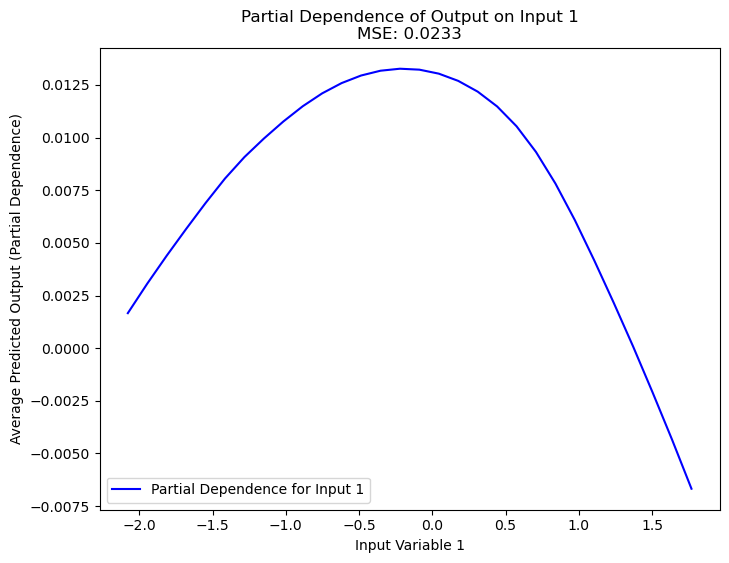

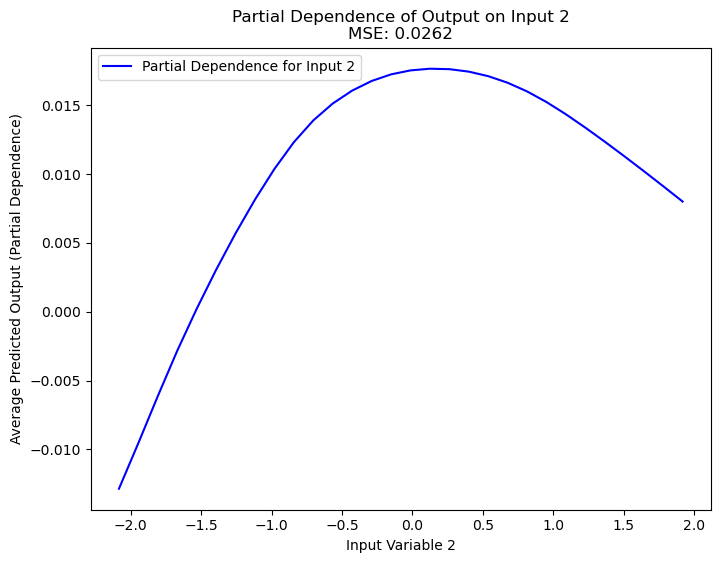

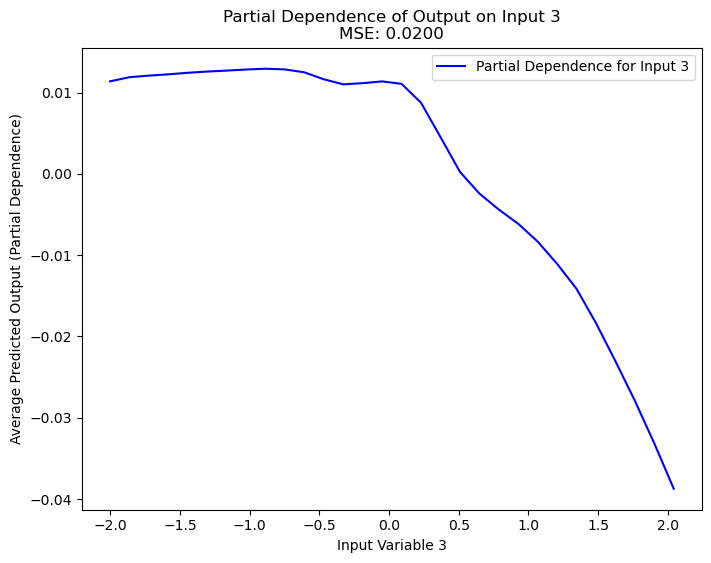

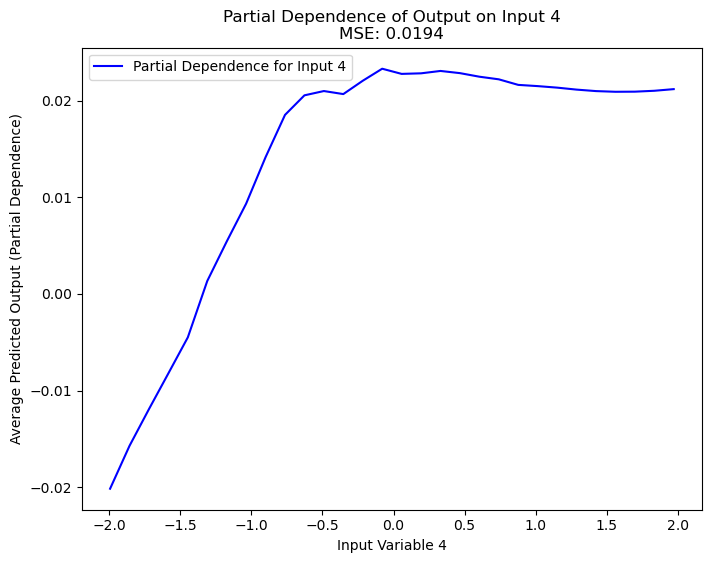

...

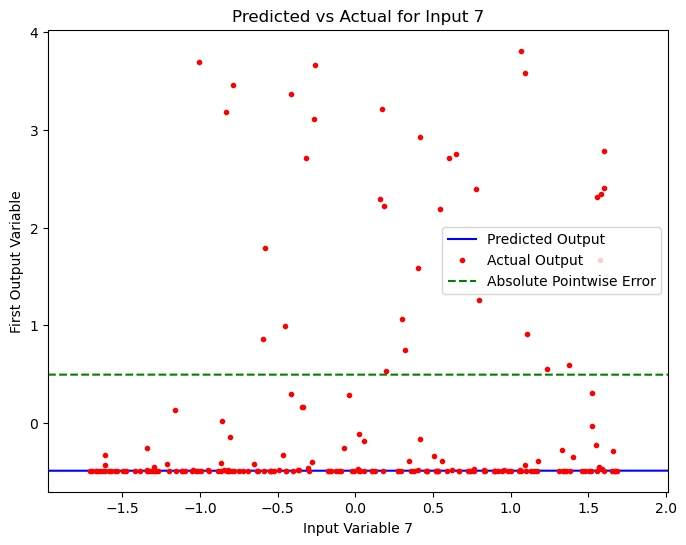

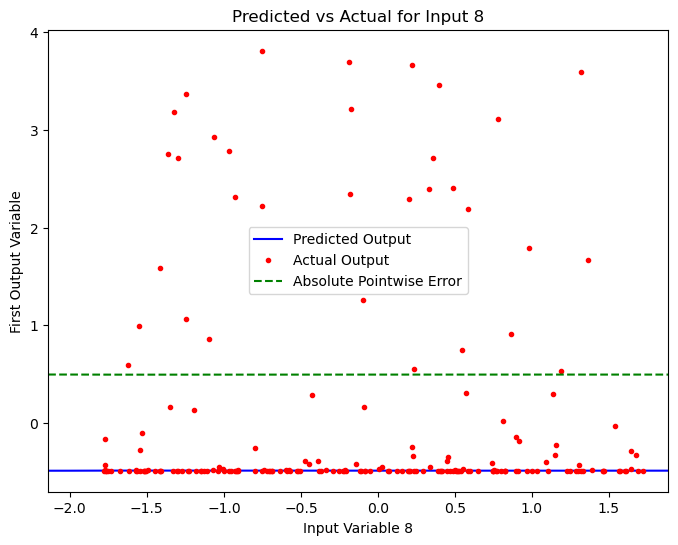

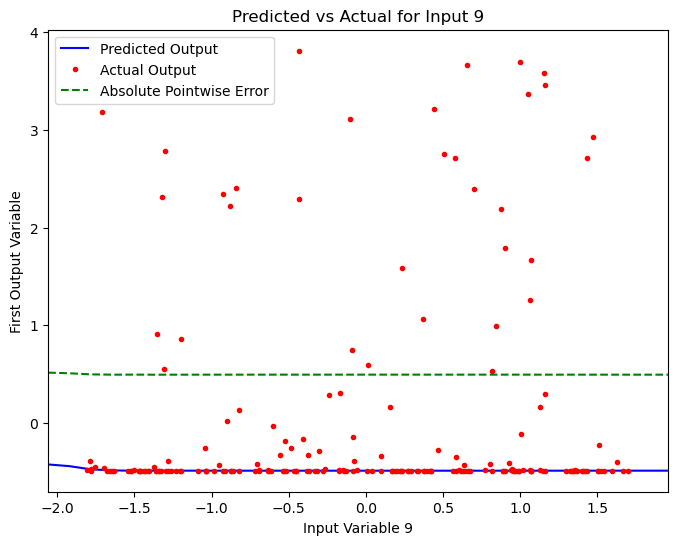

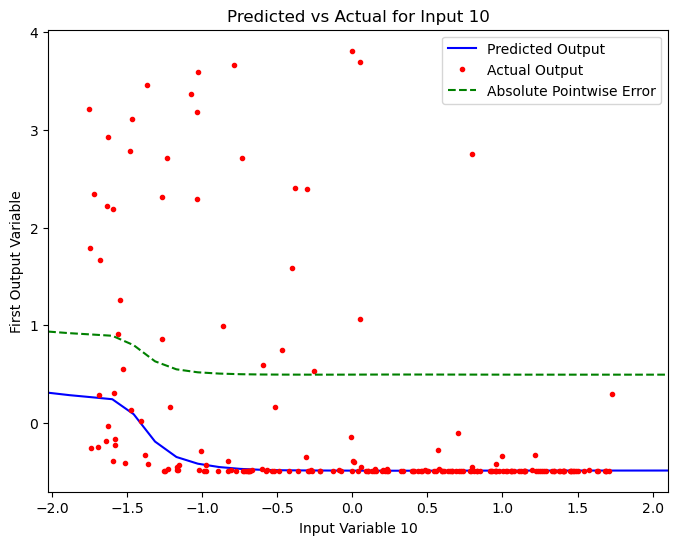

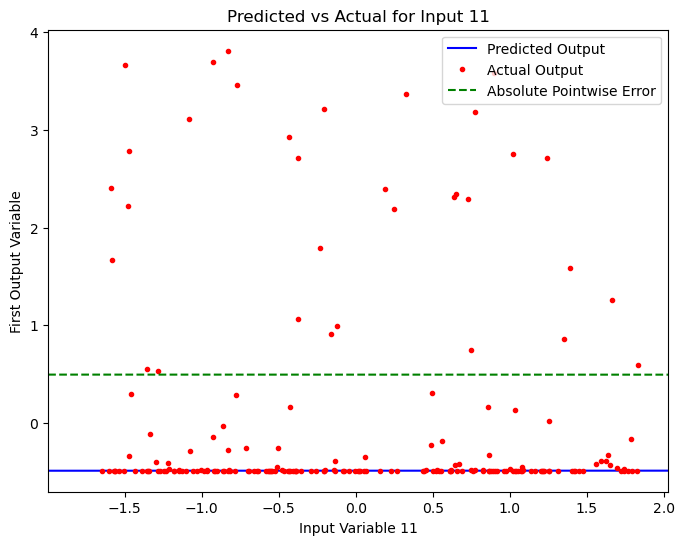

In [26]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 1000
layers = 10
nodes_per_layer = 100
total_epochs = 5000
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(5e-7 / init_rate) ** (1 / total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Track MSE and learning rate
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 2: Animated Training and Test Loss Plot ###
###########################################

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, total_epochs)
ax.set_ylim(0, max(training_losses) * 1.2)
ax.set_xlabel('Epochs')
ax.set_ylabel('Loss')
ax.set_title('Training and Test Loss Over Epochs')

train_line, = ax.plot([], [], 'b-', label='Training Loss')
test_line, = ax.plot([], [], 'r-', label='Test Loss')
ax.legend()

def init():
    train_line.set_data([], [])
    test_line.set_data([], [])
    return train_line, test_line

def update(epoch):
    train_line.set_data(range(epoch + 1), training_losses[:epoch + 1])
    if (epoch + 1) in test_epochs:
        index = test_epochs.index(epoch + 1)
        test_line.set_data(test_epochs[:index + 1], test_losses[:index + 1])

    return train_line, test_line

loss_animation = animation.FuncAnimation(fig, update, init_func=init, frames=total_epochs, interval=50, blit=True)
loss_animation.save('training_test_loss_animation.gif', writer='pillow')
plt.show()

###########################################
### PART 3: Partial Dependence and MSE Analysis ###
###########################################

input_ranges = {}
partial_dependence_results = {}
mse_partial_dependence = []

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)

    average_predictions = []
    mse_errors_for_input = []

    for value in input_ranges[i]:
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]
            
        average_predictions.append(np.mean(predictions))

        # Calculate MSE for current input setting
        mse_errors_for_input.append(((predictions - Y_test[:, 0]) ** 2).mean())

    partial_dependence_results[i] = (input_ranges[i], average_predictions)
    mse_partial_dependence.append(np.mean(mse_errors_for_input))

    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}\nMSE: {mse_partial_dependence[-1]:.4f}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual with Pointwise Error ###
###########################################

for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    pointwise_errors = []
    
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]
            predicted_outputs.append(output)
        
        # Calculate absolute pointwise error
        pointwise_errors.append(abs(output - Y_test[:, 0]).mean())

    actual_outputs = Y_test[:, 0]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.plot(input_ranges[input_idx], pointwise_errors, 'g--', label='Absolute Pointwise Error')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()


In [28]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 1000
layers = 10
nodes_per_layer = 100
total_epochs = 15000
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(5e-7 / init_rate) ** (1 / total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Track MSE and learning rate
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 2: Animated Training and Test Loss Plot ###
###########################################

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, total_epochs)
ax.set_ylim(0, max(training_losses) * 1.2)
ax.set_xlabel('Epochs')
ax.set_ylabel('Loss')
ax.set_title('Training and Test Loss Over Epochs')

train_line, = ax.plot([], [], 'b-', label='Training Loss')
test_line, = ax.plot([], [], 'r-', label='Test Loss')
ax.legend()

def init():
    train_line.set_data([], [])
    test_line.set_data([], [])
    return train_line, test_line

def update(epoch):
    train_line.set_data(range(epoch + 1), training_losses[:epoch + 1])
    if (epoch + 1) in test_epochs:
        index = test_epochs.index(epoch + 1)
        test_line.set_data(test_epochs[:index + 1], test_losses[:index + 1])

    return train_line, test_line

loss_animation = animation.FuncAnimation(fig, update, init_func=init, frames=total_epochs, interval=50, blit=True)
loss_animation.save('training_test_loss_animation.gif', writer='pillow')
plt.show()

###########################################
### PART 3: Partial Dependence and MSE Analysis ###
###########################################

input_ranges = {}
partial_dependence_results = {}
mse_partial_dependence = []

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)

    average_predictions = []
    mse_errors_for_input = []

    for value in input_ranges[i]:
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]
            
        average_predictions.append(np.mean(predictions))

        # Calculate MSE for current input setting
        mse_errors_for_input.append(((predictions - Y_test[:, 0]) ** 2).mean())

    partial_dependence_results[i] = (input_ranges[i], average_predictions)
    mse_partial_dependence.append(np.mean(mse_errors_for_input))

    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}\nMSE: {mse_partial_dependence[-1]:.4f}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual with Pointwise Error ###
###########################################

for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    pointwise_errors = []
    
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]
            predicted_outputs.append(output)
        
        # Calculate absolute pointwise error
        pointwise_errors.append(abs(output - Y_test[:, 0]).mean())

    actual_outputs = Y_test[:, 0]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.plot(input_ranges[input_idx], pointwise_errors, 'g--', label='Absolute Pointwise Error')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()


Epoch 1000/15000, Training Loss: 0.005471, Test Loss: 0.409673, Learning Rate: 0.000603
Epoch 2000/15000, Training Loss: 0.020685, Test Loss: 0.454758, Learning Rate: 0.000363
Epoch 3000/15000, Training Loss: 0.000080, Test Loss: 0.419628, Learning Rate: 0.000219
Epoch 4000/15000, Training Loss: 0.000056, Test Loss: 0.415774, Learning Rate: 0.000132
Epoch 5000/15000, Training Loss: 0.000019, Test Loss: 0.412837, Learning Rate: 0.000079
Epoch 6000/15000, Training Loss: 0.000008, Test Loss: 0.415815, Learning Rate: 0.000048
Epoch 7000/15000, Training Loss: 0.000005, Test Loss: 0.418443, Learning Rate: 0.000029
Epoch 8000/15000, Training Loss: 0.000003, Test Loss: 0.420068, Learning Rate: 0.000017
Epoch 9000/15000, Training Loss: 0.000002, Test Loss: 0.421001, Learning Rate: 0.000010
Epoch 10000/15000, Training Loss: 0.000002, Test Loss: 0.421639, Learning Rate: 0.000006
Epoch 11000/15000, Training Loss: 0.000002, Test Loss: 0.422098, Learning Rate: 0.000004
Epoch 12000/15000, Training Lo

: 

Sobol Analysis section 

Epoch 100/500, Training Loss: 0.032141, Test Loss: 0.253458, Learning Rate: 0.000222
Epoch 200/500, Training Loss: 0.019455, Test Loss: 0.255110, Learning Rate: 0.000049
Epoch 300/500, Training Loss: 0.017784, Test Loss: 0.261325, Learning Rate: 0.000011
Epoch 400/500, Training Loss: 0.017259, Test Loss: 0.266308, Learning Rate: 0.000002
Epoch 500/500, Training Loss: 0.017125, Test Loss: 0.266654, Learning Rate: 0.000001


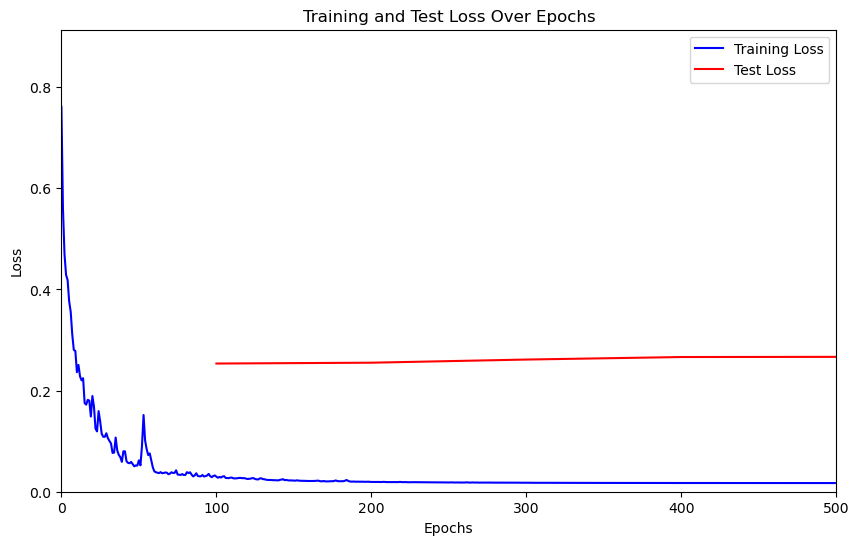

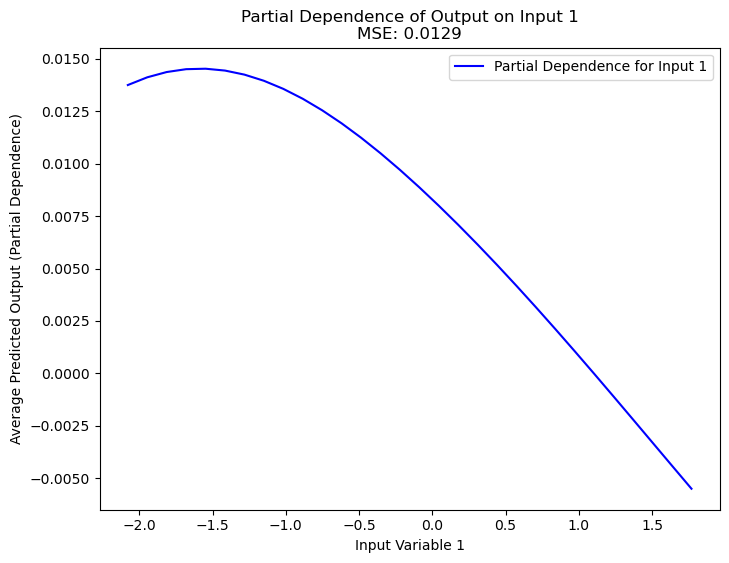

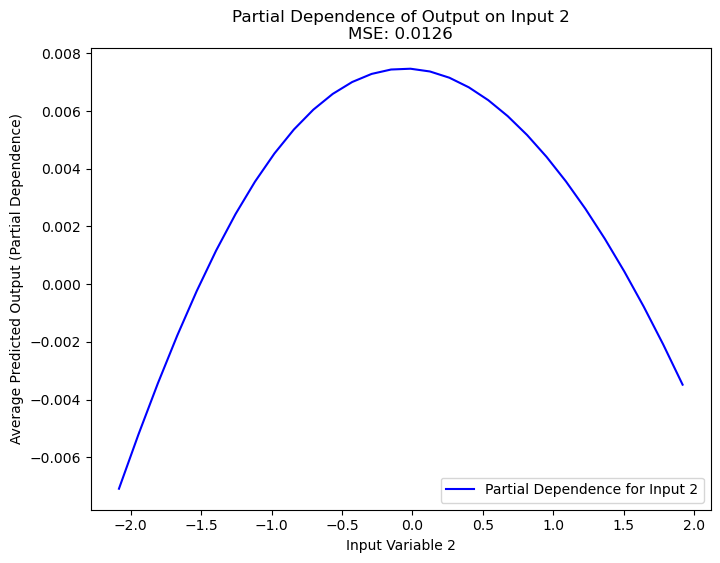

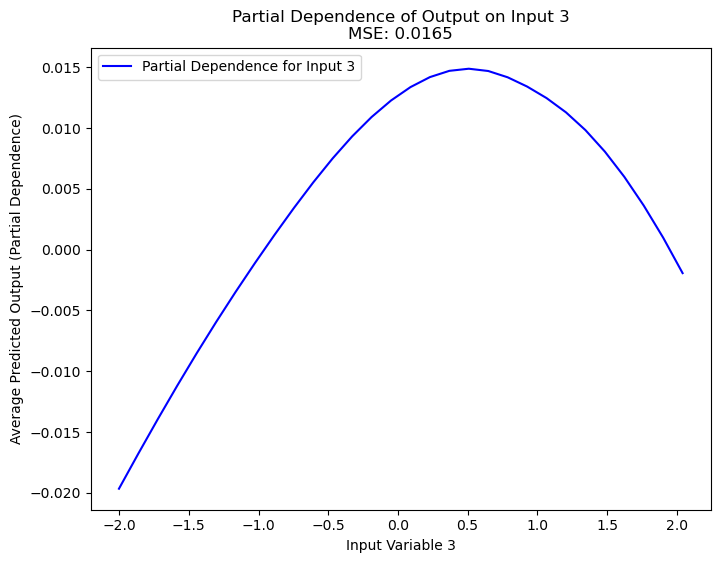

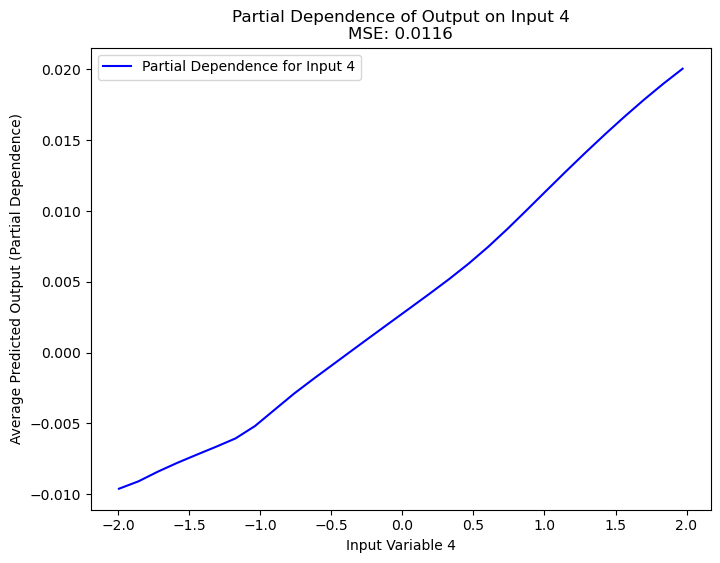

...

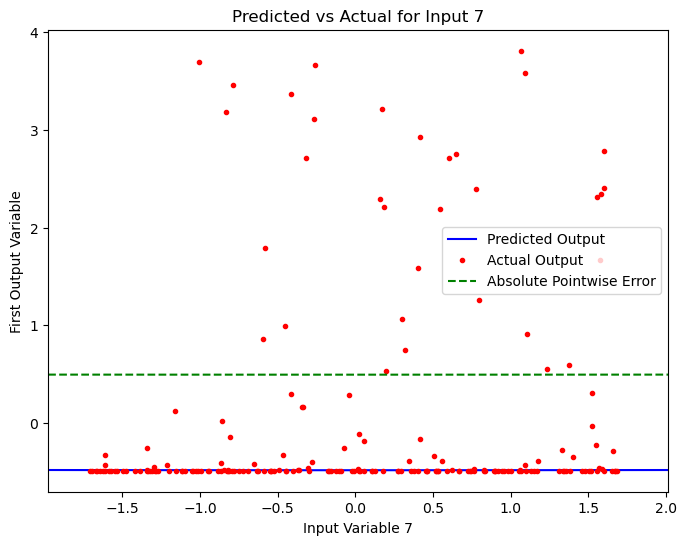

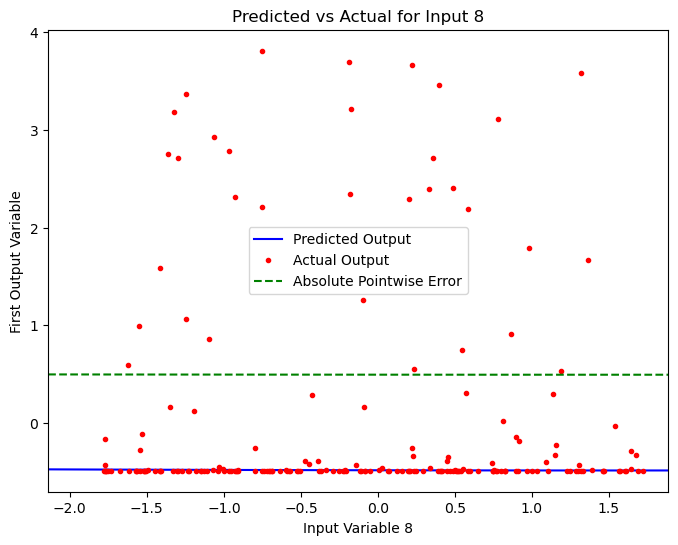

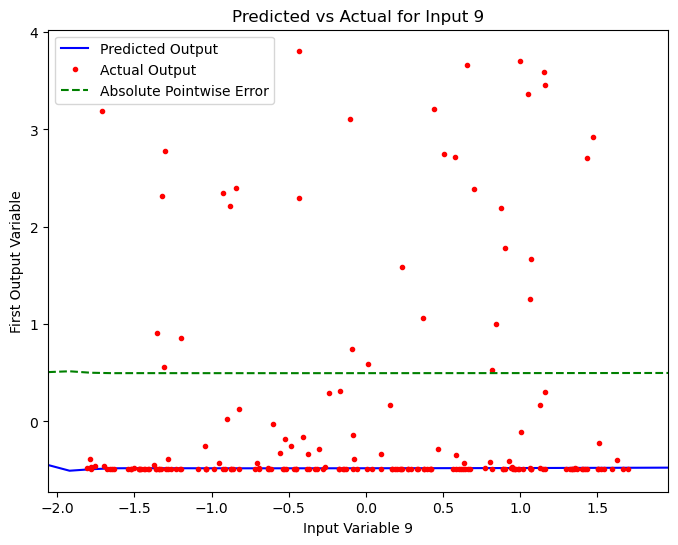

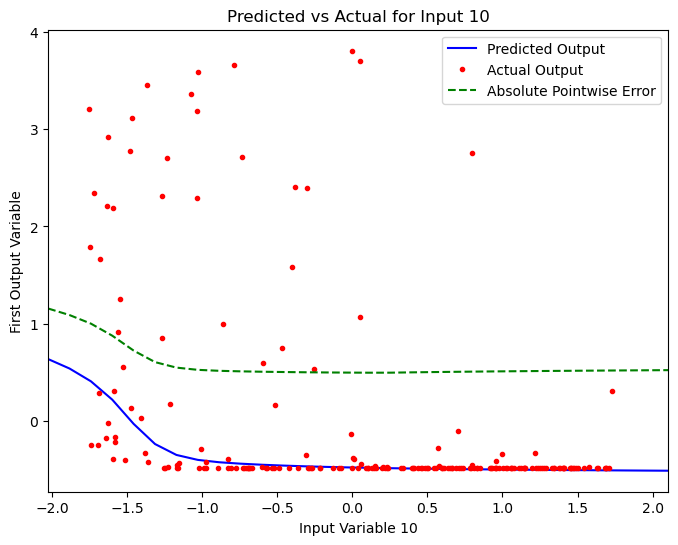

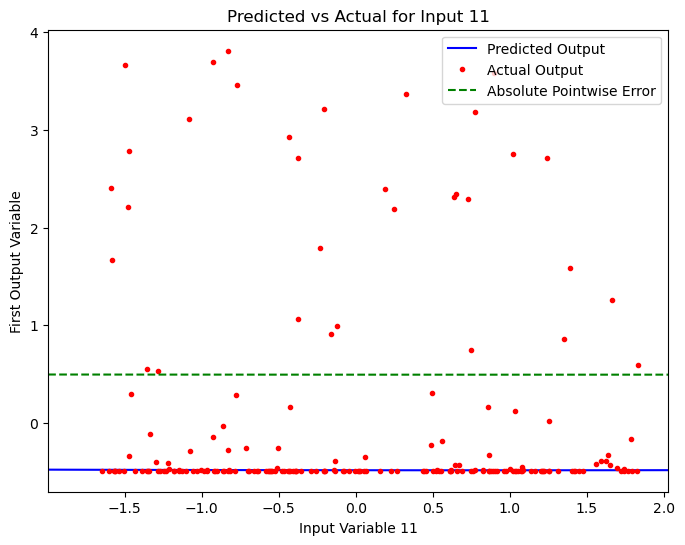

/var/folders/yr/jxh1gyj14ydcw5p3l432q1r00000gn/T/ipykernel_13223/1067131655.py:249: DeprecationWarning: `salib.sample.saltelli` will be removed in SALib 1.5.1 Please use `salib.sample.sobol`
  param_values = saltelli.sample(problem, n_samples)
/Users/shifurrahman/anaconda3/lib/python3.11/site-packages/SALib/sample/saltelli.py:110: UserWarning: 
        Convergence properties of the Sobol' sequence is only valid if
        `N` (1000) is equal to `2^n`.
        
  warnings.warn(msg)
/Users/shifurrahman/anaconda3/lib/python3.11/site-packages/SALib/util/__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


Sobol Sensitivity Analysis:
as - First-order: 0.003, Total-order: 0.004
bs - First-order: 0.003, Total-order: 0.005
ag - First-order: -0.001, Total-order: 0.006
bg - First-order: -0.007, Total-order: 0.004
N0r - First-order: 0.825, Total-order: 0.931
N0s - First-order: 0.006, Total-order: 0.004
N0g - First-order: 0.002, Total-order: 0.006
rhos - First-order: 0.001, Total-order: 0.006
rhog - First-order: 0.005, Total-order: 0.007
qc0 - First-order: 0.062, Total-order: 0.190
qi0 - First-order: -0.001, Total-order: 0.006


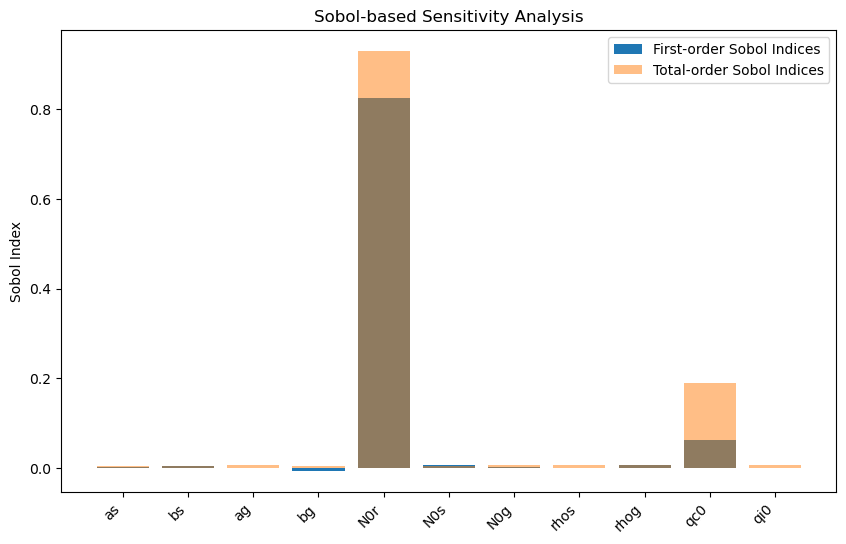

In [27]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler
from SALib.sample import saltelli
from SALib.analyze import sobol
import copy

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
split_index = int(0.8 * len(Xf_scaled))
X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], nodes_per_layer),
            nn.Tanh(),
            *(nn.Sequential(nn.Linear(nodes_per_layer, nodes_per_layer), nn.Tanh()) for _ in range(layers)),
            nn.Linear(nodes_per_layer, Y_train.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(5e-7 / init_rate) ** (1 / total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for visualization
training_losses = []
test_losses = []
mse_errors = []
learning_rates = []
test_epochs = []  # Track epochs where test loss is calculated

for epoch in range(total_epochs):
    # Training loop
    model.train()
    epoch_training_loss = 0.0

    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate average training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Track MSE and learning rate
    mse_errors.append(epoch_training_loss)  # Approximate MSE error
    learning_rates.append(optimizer.param_groups[0]['lr'])  # Track the learning rate

    # Early stopping logic
    if epoch_training_loss < best_loss:
        best_loss = epoch_training_loss
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Calculate test loss every `test_interval` epochs
    if (epoch + 1) % test_interval == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)  # Track the epoch
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {learning_rates[-1]:.6f}')

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 2: Animated Training and Test Loss Plot ###
###########################################

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, total_epochs)
ax.set_ylim(0, max(training_losses) * 1.2)
ax.set_xlabel('Epochs')
ax.set_ylabel('Loss')
ax.set_title('Training and Test Loss Over Epochs')

train_line, = ax.plot([], [], 'b-', label='Training Loss')
test_line, = ax.plot([], [], 'r-', label='Test Loss')
ax.legend()

def init():
    train_line.set_data([], [])
    test_line.set_data([], [])
    return train_line, test_line

def update(epoch):
    train_line.set_data(range(epoch + 1), training_losses[:epoch + 1])
    if (epoch + 1) in test_epochs:
        index = test_epochs.index(epoch + 1)
        test_line.set_data(test_epochs[:index + 1], test_losses[:index + 1])

    return train_line, test_line

loss_animation = animation.FuncAnimation(fig, update, init_func=init, frames=total_epochs, interval=50, blit=True)
loss_animation.save('training_test_loss_animation.gif', writer='pillow')
plt.show()

###########################################
### PART 3: Partial Dependence and MSE Analysis ###
###########################################

input_ranges = {}
partial_dependence_results = {}
mse_partial_dependence = []

for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 30)

    average_predictions = []
    mse_errors_for_input = []

    for value in input_ranges[i]:
        X_temp = np.copy(X_test)
        X_temp[:, i] = value
        
        with torch.no_grad():
            predictions = model(torch.from_numpy(X_temp).float()).numpy()[:, 0]
            
        average_predictions.append(np.mean(predictions))

        # Calculate MSE for current input setting
        mse_errors_for_input.append(((predictions - Y_test[:, 0]) ** 2).mean())

    partial_dependence_results[i] = (input_ranges[i], average_predictions)
    mse_partial_dependence.append(np.mean(mse_errors_for_input))

    plt.figure(figsize=(8, 6))
    plt.plot(input_ranges[i], average_predictions, 'b-', label=f'Partial Dependence for Input {i + 1}')
    plt.xlabel(f'Input Variable {i + 1}')
    plt.ylabel('Average Predicted Output (Partial Dependence)')
    plt.title(f'Partial Dependence of Output on Input {i + 1}\nMSE: {mse_partial_dependence[-1]:.4f}')
    plt.legend()
    plt.show()

###########################################
### PART 4: Predicted vs Actual with Pointwise Error ###
###########################################

for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    predicted_outputs = []
    pointwise_errors = []
    
    for value in input_ranges[input_idx]:
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]
            predicted_outputs.append(output)
        
        # Calculate absolute pointwise error
        pointwise_errors.append(abs(output - Y_test[:, 0]).mean())

    actual_outputs = Y_test[:, 0]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(input_ranges[input_idx], predicted_outputs, 'b-', label='Predicted Output')
    ax.plot(X_test[:, input_idx], actual_outputs, 'r.', label='Actual Output')
    ax.plot(input_ranges[input_idx], pointwise_errors, 'g--', label='Absolute Pointwise Error')
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('First Output Variable')
    ax.set_title(f'Predicted vs Actual for Input {input_idx + 1}')
    ax.legend()
    plt.show()

###########################################
### PART 5: Sobol-based Global Sensitivity Analysis ###
###########################################

# Define the problem for SALib
problem = {
    'num_vars': X_train.shape[1],
    'names': input_data.columns.tolist(),  # Use actual variable names from input data
    'bounds': [[-2, 2]] * X_train.shape[1]  # Standardized bounds assuming normalized data range
}

# Generate samples using Saltelli's sampling scheme
n_samples = 1000  # Number of samples for sensitivity analysis (adjust as needed)
param_values = saltelli.sample(problem, n_samples)

# Run the model for each sample and store outputs
Y_sobol = []

for sample in param_values:
    sample_tensor = torch.tensor(sample, dtype=torch.float32).unsqueeze(0)
    with torch.no_grad():
        model_output = model(sample_tensor).numpy()[0, 0]  # First output variable
    Y_sobol.append(model_output)

Y_sobol = np.array(Y_sobol)  # Convert to numpy array for analysis

# Perform Sobol sensitivity analysis
sobol_indices = sobol.analyze(problem, Y_sobol)

# Print Sobol indices
print("Sobol Sensitivity Analysis:")
for i, var_name in enumerate(problem['names']):
    print(f"{var_name} - First-order: {sobol_indices['S1'][i]:.3f}, Total-order: {sobol_indices['ST'][i]:.3f}")

# Plot Sobol indices for better visualization
fig, ax = plt.subplots(figsize=(10, 6))
indices = range(len(problem['names']))
ax.bar(indices, sobol_indices['S1'], label='First-order Sobol Indices')
ax.bar(indices, sobol_indices['ST'], alpha=0.5, label='Total-order Sobol Indices')
ax.set_xticks(indices)
ax.set_xticklabels(problem['names'], rotation=45, ha='right')
ax.set_ylabel('Sobol Index')
ax.set_title('Sobol-based Sensitivity Analysis')
ax.legend()
plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(error_tol/init_rate)**(1/total_epochs))

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

# Lists to store metrics for animation
training_losses = []
test_losses = []
mse_values = []
learning_rates = []
test_epochs = []

for epoch in range(total_epochs):
    model.train()
    epoch_training_loss = 0.0

    # Training loop
    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
        
        # Accumulate training loss
        epoch_training_loss += loss.item() * x_batch.size(0)
    
    # Calculate and store the mean training loss for the epoch
    epoch_training_loss /= len(X_train)
    training_losses.append(epoch_training_loss)

    # Calculate test loss every test_interval epochs
    if (epoch + 1) % 100 == 0:
        model.eval()
        with torch.no_grad():
            test_outputs = model(torch.from_numpy(X_test).float())
            test_loss = criterion(test_outputs, torch.from_numpy(Y_test).float()).item()
            test_losses.append(test_loss)
            test_epochs.append(epoch + 1)
            mse_values.append(test_loss)
            learning_rates.append(optimizer.param_groups[0]['lr'])
            print(f'Epoch {epoch + 1}/{total_epochs}, Training Loss: {epoch_training_loss:.6f}, Test Loss: {test_loss:.6f}, Learning Rate: {optimizer.param_groups[0]["lr"]:.8f}')
        model.train()  # Set model back to training mode

    # Update learning rate
    scheduler.step()

# Restore the best model
model = best_model

###########################################
### PART 3: Animated Sensitivity Analysis ###
###########################################

# Define range for each input feature for sensitivity analysis
input_ranges = {}
for i in range(X_test.shape[1]):
    input_mean = np.mean(X_test[:, i])
    input_std = np.std(X_test[:, i])
    input_ranges[i] = np.linspace(input_mean - 2 * input_std, input_mean + 2 * input_std, 50)

# Perform sensitivity analysis and animate
for input_idx in range(X_test.shape[1]):
    constant_X = np.mean(X_test, axis=0)
    output_changes = []
    
    # Set up figure and axis for the animation
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.set_xlim(input_ranges[input_idx][0], input_ranges[input_idx][-1])
    ax.set_ylim(-2, 2)  # Adjust according to your output scaling
    ax.set_xlabel(f'Input Variable {input_idx + 1} Value')
    ax.set_ylabel('Predicted First Output Variable (output1)')
    ax.set_title(f'Sensitivity of Output 1 to Input {input_idx + 1}')
    line, = ax.plot([], [], 'b-', label=f'Output sensitivity to Input {input_idx + 1}')
    ax.legend()

    # Animation init function
    def init():
        line.set_data([], [])
        return line,

    # Animation update function
    def animate(i):
        # Vary the target input feature and hold others constant
        value = input_ranges[input_idx][i]
        test_sample = np.copy(constant_X)
        test_sample[input_idx] = value
        test_sample = torch.from_numpy(test_sample).float().unsqueeze(0)
        
        # Predict the output for the current value of the input feature
        with torch.no_grad():
            output = model(test_sample).numpy()[0, 0]  # First output variable
            output_changes.append(output)
        
        # Update line data
        line.set_data(input_ranges[input_idx][:i+1], output_changes[:i+1])
        return line,

    # Create the animation for sensitivity analysis
    ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(input_ranges[input_idx]), interval=100, blit=True)
    
    # Save the animation as GIF and MP4
    ani.save(f'sensitivity_input_{input_idx + 1}.gif', writer='pillow')
    ani.save(f'sensitivity_input_{input_idx + 1}.mp4', writer='ffmpeg', fps=10)

    # Display the animation in Jupyter notebook if needed
    HTML(ani.to_jshtml())
    plt.show()



In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training loop and early stopping
best_model = copy.deepcopy(model)
best_loss = float('inf')
patience = 500
patience_counter = 0

for epoch in range(total_epochs):
    model.train()
    for x_batch, y_batch in DataLoader(TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float()), batch_size=batch_size, shuffle=True):
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    # Early stopping
    if loss.item() < best_loss:
        best_loss = loss.item()
        best_model = copy.deepcopy(model)
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

# Restore the best model
model = best_model
model.eval()

########################################
### PART 3: Animating each input vs output1 ###
########################################

# Loop over each input variable and create an animation showing its relationship with output1
for input_idx in range(X_test.shape[1]):
    # Prepare data for plotting
    varying_input = X_test[:, input_idx]  # Select the current input column
    
    # Create a copy of X_test with all elements except the current column set to their mean
    constant_input = np.mean(X_test, axis=0)
    constant_X_test = np.tile(constant_input, (len(X_test), 1))  # Duplicate to match X_test size
    constant_X_test[:, input_idx] = varying_input  # Vary only the selected input

    # Predict output for the varying input with constant other inputs
    with torch.no_grad():
        y_pred_output1 = model(torch.from_numpy(constant_X_test).float()).numpy()[:, 0]  # Only the first output variable

    # Set up the figure for the animation
    fig, ax = plt.subplots(figsize=(8, 6))
    line, = ax.plot([], [], 'bo')
    ax.set_xlim(np.min(varying_input) - 0.1, np.max(varying_input) + 0.1)
    ax.set_ylim(np.min(y_pred_output1) - 0.1, np.max(y_pred_output1) + 0.1)
    ax.set_xlabel(f'Input Variable {input_idx + 1}')
    ax.set_ylabel('Predicted First Output Variable (output1)')
    ax.set_title(f'Relationship between Input {input_idx + 1} and output1 (Other Inputs Constant)')

    # Initialize the plot line
    def init():
        line.set_data([], [])
        return line,

    # Animation function to update each frame
    def animate(i):
        line.set_data(varying_input[:i+1], y_pred_output1[:i+1])
        return line,

    # Create the animation
    ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(varying_input), interval=100, blit=True)

    # Save the animation in multiple formats
    gif_path = f'input_{input_idx + 1}_vs_output1_relationship.gif'
    mp4_path = f'input_{input_idx + 1}_vs_output1_relationship.mp4'
    ani.save(gif_path, writer='pillow')
    ani.save(mp4_path, writer='ffmpeg', fps=10)

    # Display the animation if in a Jupyter notebook environment
    display(HTML(ani.to_jshtml()))  # Display directly in Jupyter (if running in that environment)

    plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            y_pred_reshaped = y_pred.detach().numpy()
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

########################################
### PART 3: Visualizing x1 vs output1 ###
########################################

# Ensure model is in evaluation mode
model.eval()

# Prepare data for plotting
x1_test = X_test[:, 0]  # Select first column for x1

# Create a copy of X_test with all elements except the first column set to their mean
constant_input = np.mean(X_test[:, 1:], axis=0)
constant_X_test = np.copy(X_test)
constant_X_test[:, 1:] = constant_input  # Keep all variables except x1 constant

# Predict output for x1_test with constant other inputs
with torch.no_grad():
    y_pred_x1 = model(torch.from_numpy(constant_X_test).float()).numpy()[:, 0]  # Only the first output variable

# Get actual values of the first output variable for comparison
actual_y1 = Y_test[:, 0]

# Set up the figure for the animation
fig, ax = plt.subplots(figsize=(8, 6))
pred_line, = ax.plot([], [], 'bo', label='Predicted')
actual_line, = ax.plot([], [], 'go', label='Actual')
ax.set_xlim(np.min(x1_test) - 0.1, np.max(x1_test) + 0.1)
ax.set_ylim(min(np.min(y_pred_x1), np.min(actual_y1)) - 0.1, max(np.max(y_pred_x1), np.max(actual_y1)) + 0.1)
ax.set_xlabel('First Input Variable (x1)')
ax.set_ylabel('First Output Variable (output1)')
ax.set_title('Relationship between x1 and output1 (Other Inputs Constant)')
ax.legend()

# Initialize the plot lines
def init():
    pred_line.set_data([], [])
    actual_line.set_data([], [])
    return pred_line, actual_line

# Animation function to update each frame
def animate(i):
    pred_line.set_data(x1_test[:i+1], y_pred_x1[:i+1])
    actual_line.set_data(x1_test[:i+1], actual_y1[:i+1])
    return pred_line, actual_line

# Create the animation
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(x1_test), interval=100, blit=True)

# Save the animation as a GIF
ani.save('x1_output1_relationship_with_actual.gif', writer='pillow')

# Display the animation in Jupyter or IPython
# from IPython.display import HTML
# HTML(ani.to_html5_video())

plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the new DNN model
test_interval = 100
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training setup
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            y_pred_reshaped = y_pred.detach().numpy()
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

########################################
### PART 3: Visualizing x1 vs output1-6 ###
########################################

# Ensure model is in evaluation mode
model.eval()

# Prepare data for plotting
x1_test = X_test[:, 0]  # Select first column for x1

# Create a copy of X_test with all elements except the first column set to their mean
constant_input = np.mean(X_test[:, 1:], axis=0)
constant_X_test = np.copy(X_test)
constant_X_test[:, 1:] = constant_input  # Keep all variables except x1 constant

# Predict outputs for x1_test with constant other inputs
with torch.no_grad():
    y_pred_x1 = model(torch.from_numpy(constant_X_test).float()).numpy()  # Predictions for all six output variables

# Get actual values for all six output variables for comparison
actual_y = Y_test

# Set up the figure for the animation
fig, ax = plt.subplots(figsize=(10, 8))
colors = ['b', 'g', 'r', 'c', 'm', 'y']
pred_lines = []
actual_lines = []

# Initialize lines for each output variable
for i in range(6):
    (pred_line,) = ax.plot([], [], colors[i] + '-', label=f'Predicted Output {i+1}')
    (actual_line,) = ax.plot([], [], colors[i] + '--', label=f'Actual Output {i+1}')
    pred_lines.append(pred_line)
    actual_lines.append(actual_line)

ax.set_xlim(np.min(x1_test) - 0.1, np.max(x1_test) + 0.1)
ax.set_ylim(np.min(actual_y) - 0.1, np.max(actual_y) + 0.1)
ax.set_xlabel('First Input Variable (x1)')
ax.set_ylabel('Output Variables (output1 to output6)')
ax.set_title('Relationship between x1 and all outputs (Other Inputs Constant)')
ax.legend()

# Initialize the plot lines
def init():
    for i in range(6):
        pred_lines[i].set_data([], [])
        actual_lines[i].set_data([], [])
    return pred_lines + actual_lines

# Animation function to update each frame
def animate(i):
    for j in range(6):
        pred_lines[j].set_data(x1_test[:i+1], y_pred_x1[:i+1, j])
        actual_lines[j].set_data(x1_test[:i+1], actual_y[:i+1, j])
    return pred_lines + actual_lines

# Create the animation
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(x1_test), interval=100, blit=True)

# Save the animation as a GIF
ani.save('x1_output1_to_6_relationship.gif', writer='pillow')

# Display the animation in Jupyter or IPython
# from IPython.display import HTML
# HTML(ani.to_html5_video())

plt.show()


In [ ]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the new DNN model
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Training setup
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
for epoch in range(total_epochs):
    model.train()
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

# Restore the best model
model = copy.deepcopy(best_model)

########################################
### PART 3: Visualizing input vs output1 ###
########################################

# Ensure model is in evaluation mode
model.eval()

# Prepare data for plotting
num_inputs = X_test.shape[1]  # Number of input variables
constant_X_test = np.mean(X_test, axis=0)  # Mean of each input variable

# Set up the figure for the animation
fig, ax = plt.subplots(figsize=(10, 8))
pred_line, = ax.plot([], [], 'b-', label='Predicted')
actual_line, = ax.plot([], [], 'g--', label='Actual')
ax.set_xlabel('Input Variable Value')
ax.set_ylabel('First Output Variable (output1)')
ax.set_title('Relationship between each input variable and output1')
ax.legend()

# Initialize the plot lines
def init():
    pred_line.set_data([], [])
    actual_line.set_data([], [])
    return pred_line, actual_line

# Animation function to update each frame
def animate(input_idx):
    # Vary only one input variable, keeping the others constant
    varying_input_values = X_test[:, input_idx]  # Varying values of the selected input
    varying_X_test = np.tile(constant_X_test, (len(varying_input_values), 1))  # Copy constant values
    varying_X_test[:, input_idx] = varying_input_values  # Only vary the selected input

    # Predict output for varying input
    with torch.no_grad():
        y_pred = model(torch.from_numpy(varying_X_test).float()).numpy()[:, 0]  # Only the first output variable

    # Get actual output for comparison
    actual_y = Y_test[:, 0]  # Only the first output variable

    # Update plot data
    ax.set_xlim(np.min(varying_input_values) - 0.1, np.max(varying_input_values) + 0.1)
    ax.set_ylim(min(np.min(y_pred), np.min(actual_y)) - 0.1, max(np.max(y_pred), np.max(actual_y)) + 0.1)
    pred_line.set_data(varying_input_values, y_pred)
    actual_line.set_data(varying_input_values, actual_y)
    ax.set_xlabel(f'Input Variable {input_idx + 1} Value')  # Update x-axis label for current input variable
    return pred_line, actual_line

# Create the animation with one frame per input variable
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=num_inputs, interval=1000, blit=True)

# Save the animation as a GIF
ani.save('input_vs_output1_relationship.gif', writer='pillow')

# Display the animation in Jupyter or IPython
# from IPython.display import HTML
# HTML(ani.to_html5_video())

plt.show()


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Print shapes for debugging
print("Shape of X_test:", X_test.shape)          # Expected: (200, 11)
print("Shape of Y_test:", Y_test.shape)          # Expected: (200, 6)
print("First 5 rows of Y_test:\n", Y_test[:5])   # Verify content

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            y_pred_reshaped = y_pred.detach().numpy()
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Static plot for verification
plt.figure(figsize=(10, 6))
plt.plot(range(len(Y_test)), Y_test[:, 0], 'b', label='True (First Variable)')
plt.plot(range(len(predictions[-1])), predictions[-1][:, 0], 'r', label='Predicted (First Variable)')
plt.xlabel("Test Samples")
plt.ylabel("Value")
plt.legend()
plt.title("True vs Predicted for First Variable (Static)")
plt.show()

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # First output variable (e.g., pcp)
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # First output variable prediction
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for first output
    line4.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line5.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]) - 0.1, np.max(Y_test[:, 0]) + 0.1))
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]) - 0.1, np.max(Y_test[:, 0]) + 0.1))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted'])
ax2.legend(['Predicted'])
ax3.legend(['Pointwise Absolute Error'])
ax4.legend(['MSE training loss','MSE testing loss'])

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=False)

# Save the animation as a GIF
anim.save('animation.gif', writer='pillow')

# Display the animation in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.detach().numpy()  # Keep 2D structure (200, 6)
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test:", X_test.shape)
print("Shape of y_pred:", y_pred.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################

def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    # Plot for first output variable (e.g., pcp)
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # First output variable (e.g., pcp)
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # First output variable prediction
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for first output
    line4.set_data(model_steps[0:(n-1)*test_interval], np.abs(model_losses[0:(n-1)*test_interval]))
    line5.set_data(model_prediction_steps[0:n], np.abs(model_test_losses[0:n]))
    return (line1, line2, line3, line4, line5)

# Set up the figure for the animation
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))  # For the first output variable
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'b', lw=1)
line6, = ax4.semilogy([], [], 'r', lw=1)
ax1.legend(['True', 'Predicted']);
ax2.legend(['Predicted']);
ax3.legend(['Pointwise Absolute Error']);
ax4.legend(['MSE training loss','MSE testing loss']);

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())

# Now, let's add the animation for the relationship between x1 and output1
# Prepare data for plotting
x1_test = X_test[:, 0]  # Select first column for x1

# Create a copy of X_test with all elements except the first column set to their mean
constant_input = np.mean(X_test[:, 1:], axis=0)
constant_X_test = np.copy(X_test)
constant_X_test[:, 1:] = constant_input

# Predict output for x1_test with constant other inputs
y_pred_x1 = model(torch.from_numpy(constant_X_test).float()).detach().numpy()[:, 0]

# Set up the figure for the animation
fig2, ax2 = plt.subplots()

# Initialize the plot
line2, = ax2.plot([], [], 'bo')

# Set the plot limits
ax2.set_xlim(min(x1_test), max(x1_test))
ax2.set_ylim(min(y_pred_x1), max(y_pred_x1))
ax2.set_xlabel('First Input Variable (x1)')
ax2.set_ylabel('Predicted Output (output1)')
ax2.set_title('Relationship between x1 and output1 (Other Inputs Constant)')

# Animation function
def animate2(i):
    line2.set_data(x1_test[:i+1], y_pred_x1[:i+1])
    return line2,

# Create the animation
ani2 = animation.FuncAnimation(fig2, animate2, frames=len(x1_test), interval=100)

# Display the animation
plt.show()


In [ ]:
print("Shape of X_test:", X_test.shape)
print("Shape of Y_test:", Y_test.shape)
print("First few rows of Y_test:", Y_test[:5, 0])


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.detach().numpy()  # Keep 2D structure (200, 6)
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test:", X_test.shape)
print("Shape of y_pred:", y_pred.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################


def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    # Plot for the first output variable (e.g., pcp)
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # True values for the first output variable
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # Predicted values for the first output variable
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for the first output
    line4.set_data(model_steps[:n], np.abs(model_losses[:n]))  # Training MSE loss for all steps
    line5.set_data(model_prediction_steps[:n], np.abs(model_test_losses[:n]))  # Testing MSE loss for validation steps
    line6.set_data(model_steps[:n], np.abs(model_losses[:n]))  # Include training loss in the MSE plot
    return line1, line2, line3, line4, line5, line6  # Return all lines

# Update the figure and lines for both training and testing loss
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))  # For the first output variable
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'r', lw=1)  # Testing loss
line6, = ax4.semilogy([], [], 'b', lw=1)  # Training loss
ax1.legend(['True', 'Predicted'])
ax2.legend(['Predicted'])
ax3.legend(['Pointwise Absolute Error'])
ax4.legend(['MSE testing loss', 'MSE training loss'])  # Added labels for both training and testing loss

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    if epoch % test_interval == 0:
        model.eval()
        with torch.no_grad():
            y_pred = model(torch.from_numpy(X_test).float())
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            predictions.append(y_pred.numpy())  # Save for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

    losses.append(loss.item())
    steps.append(epoch)

    if loss.item() < best_loss:
        best_loss = loss.item()
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)

    if epoch - best_loss_epoch > patience:
        print("Early stopping")
        break

# Final test error
model.eval()
with torch.no_grad():
    final_preds = model(torch.from_numpy(X_test).float())
    final_test_error = criterion(final_preds, torch.from_numpy(Y_test).float())
print(f"Final Test Error: {final_test_error.item()}")

# Sensitivity Analysis
def sensitivity_analysis(model, X_data, feature_index):
    var_values = np.linspace(np.min(X_data[:, feature_index]), np.max(X_data[:, feature_index]), 100)
    modified_X = np.tile(X_data.mean(axis=0), (100, 1))
    modified_X[:, feature_index] = var_values

    model.eval()
    with torch.no_grad():
        predictions = model(torch.from_numpy(modified_X).float()).numpy()

    plt.figure()
    for i in range(predictions.shape[1]):
        plt.plot(var_values, predictions[:, i], label=f'Output {i+1}')
    plt.title('Sensitivity Analysis')
    plt.xlabel('Feature Value')
    plt.ylabel('Model Output')
    plt.legend()
    plt.show()

# Perform sensitivity analysis on the first feature
sensitivity_analysis(model, X_train, 0)

# Animation of the training process
fig, ax = plt.subplots()
lines = [ax.plot(steps, losses, label='Training Loss')[0],
         ax.plot(prediction_steps, test_losses, label='Validation Loss')[0]]

def init():
    for line in lines:
        line.set_data([], [])
    return lines

def update(num):
    lines[0].set_data(steps[:num], losses[:num])
    lines[1].set_data(prediction_steps[:min(num, len(prediction_steps))], test_losses[:min(num, len(prediction_steps))])
    return lines

ani = animation.FuncAnimation(fig, update, frames=len(steps), init_func=init, blit=True)
plt.legend()
plt.show()

# Save animation
ani.save('training_process.gif', writer='pillow')

# Display in Jupyter
HTML(ani.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(Xf_scaled.shape[1], 100),
            nn.Tanh(),
            *[layer for _ in range(9) for layer in (nn.Linear(100, 100), nn.Tanh())],
            nn.Linear(100, HXf_t1_scaled.shape[1])
        )

    def forward(self, x):
        return self.layers(x)

# Initialize model and settings
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Sensitivity analysis setup
def sensitivity_analysis(model, base_input, variable_index, outputs_index):
    # Range of values for the input variable being analyzed
    linspace = np.linspace(-3, 3, 300)
    modified_inputs = np.tile(base_input, (300, 1))
    modified_inputs[:, variable_index] = linspace

    # Generate predictions for each value
    predictions = model(torch.tensor(modified_inputs, dtype=torch.float32)).detach().numpy()

    # Plotting
    fig, ax = plt.subplots()
    ax.plot(linspace, predictions[:, outputs_index])
    ax.set_title(f"Sensitivity of Output {outputs_index+1} to Input {variable_index+1}")
    ax.set_xlabel("Input Feature Value")
    ax.set_ylabel("Model Output")
    plt.show()

    return fig, ax

# Example: Analyzing sensitivity of the first output with respect to the first feature
base_input = np.mean(Xf_scaled, axis=0)
fig, ax = sensitivity_analysis(model, base_input, 0, 0)

# Save the plot as an animation
def update(frame):
    ax.clear()
    ax.plot(linspace[:frame], predictions[:frame, 0])
    ax.set_title(f"Sensitivity of Output 1 to Input 1")
    ax.set_xlabel("Input Feature Value")
    ax.set_ylabel("Model Output")

ani = animation.FuncAnimation(fig, update, frames=len(linspace), repeat=False)
ani.save('sensitivity_analysis.gif', writer='pillow', fps=30)

# Display the animation in IPython
HTML(ani.to_html5_video())


In [ ]:

import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Check original shapes before flattening
print("Original shape of X_test:", X_test.shape)
print("Original shape of Y_test:", Y_test.shape)

# Parameters for the new DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler with exponential decay
exp_decay_sched = True
if exp_decay_sched:
    decay_rate = (error_tol/init_rate)**(1/total_epochs)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate, last_epoch=-1)
else:
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10, factor=0.5)

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping parameters
best_loss_epoch = 0
best_loss = float('inf')
patience = 500  # Number of epochs to wait for improvement
patience_counter = 0
best_model = copy.deepcopy(model)

# Training loop
predictions = []
prediction_steps = []
test_losses = []
losses = []
steps = []

for epoch in range(total_epochs):
    model.train()
    steps.append(epoch)
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    current_loss = loss.item()
    losses.append(current_loss)

    if exp_decay_sched:
        scheduler.step()
    else:
        scheduler.step(current_loss)  # Update learning rate based on training loss

    current_lr = optimizer.state_dict()['param_groups'][0]['lr']

    # Early stopping check
    if current_loss < best_loss:
        best_loss = current_loss
        best_loss_epoch = epoch
        best_model = copy.deepcopy(model)
        patience_counter = 0  # Reset counter if we have an improvement
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print('Early stopping triggered')
            break

    # Validation at intervals
    if epoch % test_interval == 0:
        with torch.no_grad():
            model.eval()
            y_pred = model(torch.from_numpy(X_test).float())
            print("Shape of y_pred (before reshaping):", y_pred.shape)  # Check shape of y_pred before flattening
            y_pred_reshaped = y_pred.detach().numpy()  # Keep 2D structure (200, 6)
            test_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            print(f'Epoch {epoch:5d}: Loss = {loss.item():5.8e}, Validation Loss = {test_loss.item():5.8e}, LR = {current_lr:5.8e}')
            predictions.append(y_pred_reshaped)  # Save reshaped predictions for animation
            test_losses.append(test_loss.item())
            prediction_steps.append(epoch)

# Ensure there is at least one prediction before generating the animation
if len(predictions) == 0:
    raise ValueError("No predictions generated during training. Check training loop.")

# Restore the best model
if best_loss < current_loss:
    print(f'Restoring model from memory, best epoch = {best_loss_epoch}')
    model = copy.deepcopy(best_model)

# Final test predictions
y_final_pred = model(torch.from_numpy(X_test).float())
final_test_err = criterion(y_final_pred, torch.from_numpy(Y_test).float())
print('Final Test Error:', final_test_err.item())

# Print the shape of X_test and y_pred after reshaping
print("Shape of X_test:", X_test.shape)
print("Shape of y_pred:", y_pred.shape)

# Plot training loss
def plot_loss(history_losses):
    plt.plot(history_losses)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_loss(losses)

#####################################
### PART 3: Generating animations ###
#####################################


def drawframe(n, x_test_data, y_test_data, model_predictions, model_prediction_steps, model_test_losses, model_steps, model_losses):
    # Plot for the first output variable (e.g., pcp)
    line1.set_data(range(len(x_test_data)), y_test_data[:, 0])  # True values for the first output variable
    line2.set_data(range(len(x_test_data)), model_predictions[n][:, 0])  # Predicted values for the first output variable
    line3.set_data(range(len(x_test_data)), abs(y_test_data[:, 0] - model_predictions[n][:, 0]))  # Error for the first output
    line4.set_data(model_steps[:n], np.abs(model_losses[:n]))  # Training MSE loss for all steps
    line5.set_data(model_prediction_steps[:n], np.abs(model_test_losses[:n]))  # Testing MSE loss for validation steps
    line6.set_data(model_steps[:n], np.abs(model_losses[:n]))  # Include training loss in the MSE plot
    return line1, line2, line3, line4, line5, line6  # Return all lines

# Update the figure and lines for both training and testing loss
fig = plt.figure(figsize=(12,10))
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 2, 3)
ax4 = plt.subplot(2, 2, 4)

# Set limits and labels for the plots
ax1.set_xlim((0, len(X_test)))
ax1.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))  # For the first output variable
ax1.set_xlabel('Test Samples')
ax1.set_ylabel('True/Predicted (First Variable)')

ax2.set_xlim((0, len(X_test)))
ax2.set_ylim((np.min(Y_test[:, 0]), np.max(Y_test[:, 0])))
ax2.set_xlabel('Test Samples')
ax2.set_ylabel('Predictions Only (First Variable)')

ax3.set_xlim((0, len(X_test)))
ax3.set_ylim((1e-12, 1e2))
ax3.set_xlabel('Test Samples')
ax3.set_ylabel('Absolute error |True - Predicted|')

ax4.set_xlim((0, total_epochs))
ax4.set_ylim((1e-12, 1e2))
ax4.set_xlabel('Epoch')
ax4.set_ylabel('MSE Loss')

# Set titles and legends
txt_title1 = ax1.set_title('True vs Predicted (First Variable)')
txt_title2 = ax2.set_title('Predicted (First Variable)')
txt_title3 = ax3.set_title('Pointwise Absolute Error (First Variable)')
txt_title4 = ax4.set_title('MSE Loss vs Epoch')
line1, = ax1.plot([], [], 'b', lw=2)
line2, = ax1.plot([], [], 'r', lw=2)
line3, = ax2.plot([], [], 'r', lw=2)
line4, = ax3.semilogy([], [], 'g', lw=1)
line5, = ax4.semilogy([], [], 'r', lw=1)  # Testing loss
line6, = ax4.semilogy([], [], 'b', lw=1)  # Training loss
ax1.legend(['True', 'Predicted'])
ax2.legend(['Predicted'])
ax3.legend(['Pointwise Absolute Error'])
ax4.legend(['MSE testing loss', 'MSE training loss'])  # Added labels for both training and testing loss

# Generate animation using pillow writer
anim = animation.FuncAnimation(fig, drawframe, frames=len(predictions),
                               fargs=(X_test, Y_test, predictions,
                                      prediction_steps, test_losses, steps,
                                      losses), interval=100, blit=True)

# Save the animation as a GIF using Pillow
anim.save('animation.gif', writer='pillow')

# Display the animation as a video in Jupyter or IPython
HTML(anim.to_html5_video())


In [ ]:
import os
import time
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import random as python_random
import copy
from sklearn.preprocessing import StandardScaler
from IPython.display import HTML

# Load the input data from CSV
input_csv_path = './cloud_column_model/crm1d_input_params.csv'
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load input (Xf) and output (HXf)
input_data = pd.read_csv(input_csv_path)  # Load input parameters
output_data = pd.read_csv(output_csv_path)  # Load the output data for 6 time steps

# Select only the output for the first time step (pcp_t1, acc_t1, lwp_t1, iwp_t1, olr_t1, osr_t1)
output_data_t1 = output_data[['pcp_t1', 'acc_t1', 'lwp_t1', 'iwp_t1', 'olr_t1', 'osr_t1']]

# Convert input and output data to numpy arrays
Xf = input_data.values  # Input data
HXf_t1 = output_data_t1.values  # Output for time step 1

# Normalize the input and output data
scaler_X = StandardScaler()
scaler_Y = StandardScaler()

Xf_scaled = scaler_X.fit_transform(Xf)  # Normalize input
HXf_t1_scaled = scaler_Y.fit_transform(HXf_t1)  # Normalize output

# Split data into training and testing sets (80% training, 20% testing)
n_samples = len(Xf_scaled)
split_index = int(0.8 * n_samples)

X_train, X_test = Xf_scaled[:split_index], Xf_scaled[split_index:]
Y_train, Y_test = HXf_t1_scaled[:split_index], HXf_t1_scaled[split_index:]

# Parameters for the DNN model
test_interval = 100
activation = 'tanh'
layers = 10
nodes_per_layer = 100
total_epochs = 500
error_tol = 5e-7
init_rate = 0.001
batch_size = 32  # Batch size for training

# Define the neural network model
class DNN(nn.Module):
    def __init__(self):
        super(DNN, self).__init__()
        self.layers = nn.Sequential()
        self.layers.add_module("input_layer", nn.Linear(X_train.shape[1], nodes_per_layer))
        for layer in range(layers):
            self.layers.add_module(f"dense_{layer}", nn.Linear(nodes_per_layer, nodes_per_layer))
            self.layers.add_module(f"activation_{layer}", nn.Tanh())
        self.layers.add_module("output_layer", nn.Linear(nodes_per_layer, Y_train.shape[1]))

    def forward(self, x):
        return self.layers(x)

# Initialize model, loss function, and optimizer
model = DNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=init_rate)

# Learning rate scheduler
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=(error_tol/init_rate)**(1/total_epochs))

# Prepare data loaders
train_dataset = TensorDataset(torch.from_numpy(X_train).float(), torch.from_numpy(Y_train).float())
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Early stopping setup
best_loss = float('inf')
best_model = copy.deepcopy(model)

# Training loop
losses = []
validation_losses = []
predictions = []  # To store predictions for animation

for epoch in range(total_epochs):
    model.train()
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    # Record training loss
    losses.append(loss.item())
    scheduler.step()

    # Validation phase
    if epoch % test_interval == 0:
        model.eval()
        with torch.no_grad():
            y_pred = model(torch.from_numpy(X_test).float())
            validation_loss = criterion(y_pred, torch.from_numpy(Y_test).float())
            validation_losses.append(validation_loss.item())
            predictions.append(y_pred.numpy())  # Store predictions for animation
            if validation_loss < best_loss:
                best_loss = validation_loss
                best_model = copy.deepcopy(model)

# Restore the best model for final evaluation
model.load_state_dict(best_model.state_dict())
model.eval()
final_preds = model(torch.from_numpy(X_test).float())
final_loss = criterion(final_preds, torch.from_numpy(Y_test).float())
print("Final Test Loss:", final_loss.item())

# Animation of the training process
fig, ax = plt.subplots()
line, = ax.plot(X_test, Y_test, 'r-', label='True Data')
line2, = ax.plot(X_test, predictions[0], 'b-', label='Predicted Data')

def update(num, X_test, predictions, line):
    line.set_data(X_test, predictions[num])
    return line,

ani = animation.FuncAnimation(fig, update, len(predictions), fargs=[X_test, predictions, line2],
                              interval=100, blit=True)
plt.legend()
plt.show()

# Save the animation as a GIF
ani.save('training_animation.gif', writer='pillow')


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch
from torch import nn

# Example neural network for demonstration
class DNN(nn.Module):
    def __init__(self, input_size, output_size):
        super(DNN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(input_size, 100),
            nn.Tanh(),
            *[layer for _ in range(9) for layer in (nn.Linear(100, 100), nn.Tanh())],
            nn.Linear(100, output_size)
        )

    def forward(self, x):
        return self.layers(x)

# Prepare the model input
input_size = 10  # assume 10 features
output_size = 6  # assume 6 outputs
model = DNN(input_size, output_size)
X = np.random.randn(1, input_size)  # Single sample with 10 features

# Sensitivity analysis setup
def sensitivity_analysis(model, base_input, variable_index, output_index):
    global predictions, linspace
    linspace = np.linspace(-3, 3, 300)
    modified_inputs = np.tile(base_input, (300, 1))
    modified_inputs[:, variable_index] = linspace

    # Generate predictions for each value
    predictions = model(torch.tensor(modified_inputs, dtype=torch.float32)).detach().numpy()
    return predictions

# Selecting a variable index and an output index for analysis
variable_index = 0  # Index of the input feature to vary
output_index = 0  # Index of the output feature to observe

# Running the sensitivity analysis
predictions = sensitivity_analysis(model, X, variable_index, output_index)

# Animation setup
fig, ax = plt.subplots()
line, = ax.plot([], [], 'r-')  # start with an empty line
ax.set_xlim(np.min(linspace), np.max(linspace))
ax.set_ylim(np.min(predictions[:, output_index]), np.max(predictions[:, output_index]))
ax.set_xlabel("Input Feature Value")
ax.set_ylabel("Model Output")

def update(num, x, y, line):
    line.set_data(x[:num], y[:num])
    return line,

ani = animation.FuncAnimation(fig, update, len(linspace), fargs=[linspace, predictions[:, output_index], line],
                              repeat=False)

# Save the animation as a GIF
ani.save('sensitivity_analysis.gif', writer='pillow', fps=30)

# Display the animation in the notebook
HTML(ani.to_html5_video())


In [ ]:
# Load the CSV file
output_csv_path = './cloud_column_model/crm1d_output.csv'
HXf_df = pd.read_csv(output_csv_path)

# Print the column names to see how they are structured
print(HXf_df.columns)

In [ ]:


# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables (repeated across 6 time steps)
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Number of time steps (6 time steps in this case)
n_time_steps = 6

# Plotting the ensemble output for each of the 6 variables across 6 time steps
plt.figure(figsize=(15, 18))

# Loop through each variable and plot for 1000 ensemble members over 6 time steps
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    plt.subplot(3, 2, i+1)  # Create a 3x2 grid of subplots
    for t in range(n_time_steps):
        # Get the corresponding column for the variable and time step
        col_name = f'{var}_t{t+1}'  # e.g., 'pcp_t1', 'acc_t2'
        variable_data = HXf_df[col_name]
        plt.plot(variable_data, label=f'Time Step {t+1}', alpha=0.6)
    
    plt.title(var_names[i])
    plt.xlabel('Ensemble Member')
    plt.ylabel(var_names[i])
    plt.grid(True)
    plt.legend()  # Add a legend for the time steps

# Adjust layout and show the plot
plt.tight_layout()
plt.show()



In [ ]:


# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Number of ensemble members
n_ens = 1000

# Create a new DataFrame to store the average values for each variable across time steps
avg_values_df = pd.DataFrame(index=range(n_ens))

# Loop through each variable and compute the average across 6 time steps
for var in ['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']:
    cols = [f'{var}_t{t+1}' for t in range(6)]  # e.g., ['pcp_t1', 'pcp_t2', ...]
    avg_values_df[var] = HXf_df[cols].mean(axis=1)  # Compute the average across time steps

# Plot the average ensemble output for each of the 6 variables
plt.figure(figsize=(15, 10))

# Loop through each variable and plot its average for all ensemble members
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    plt.subplot(3, 2, i+1)  # Create a 3x2 grid of subplots
    plt.plot(avg_values_df[var], 'b-', alpha=0.6)  # Plot the average values for the variable
    plt.title(var_names[i])
    plt.xlabel('Ensemble Member')
    plt.ylabel(var_names[i])
    plt.grid(True)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [ ]:


# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Number of ensemble members
n_ens = 1000

# Create a new DataFrame to store the average, Q1 (25th percentile), and Q3 (75th percentile) values
avg_values_df = pd.DataFrame(index=range(n_ens))
q1_values_df = pd.DataFrame(index=range(n_ens))
q3_values_df = pd.DataFrame(index=range(n_ens))

# Loop through each variable and compute the average, Q1, and Q3 across 6 time steps
for var in ['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']:
    cols = [f'{var}_t{t+1}' for t in range(6)]  # e.g., ['pcp_t1', 'pcp_t2', ...]
    avg_values_df[var] = HXf_df[cols].mean(axis=1)  # Compute the average across time steps
    q1_values_df[var] = HXf_df[cols].quantile(0.25, axis=1)  # Compute the 25th percentile (Q1)
    q3_values_df[var] = HXf_df[cols].quantile(0.75, axis=1)  # Compute the 75th percentile (Q3)

# Plot the average ensemble output for each of the 6 variables, along with the IQR as uncertainty bounds
plt.figure(figsize=(15, 10))

# Loop through each variable and plot its average with IQR bounds for all ensemble members
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    plt.subplot(3, 2, i+1)  # Create a 3x2 grid of subplots
    
    # Plot the average values
    plt.plot(avg_values_df[var], 'b-', alpha=0.6, label='Mean')  # Plot the average values for the variable
    
    # Plot the IQR (between Q1 and Q3)
    plt.fill_between(range(n_ens), q1_values_df[var], q3_values_df[var], color='gray', alpha=0.3, label='IQR (Q1 to Q3)')
    
    plt.title(var_names[i])
    plt.xlabel('Ensemble Member')
    plt.ylabel(var_names[i])
    plt.grid(True)
    plt.legend()  # Add a legend for the mean and IQR

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [ ]:
# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Number of ensemble members
n_ens = 1000

# Plot the box plot for each variable across ensemble members
plt.figure(figsize=(15, 10))

# Loop through each variable and create a box plot for the ensemble members
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    plt.subplot(3, 2, i+1)  # Create a 3x2 grid of subplots
    
    # Extract data for the six time steps for all ensemble members for the given variable
    cols = [f'{var}_t{t+1}' for t in range(6)]  # e.g., ['pcp_t1', 'pcp_t2', ..., 'pcp_t6']
    
    # Transpose the data so that each column represents an ensemble member
    transposed_data = HXf_df[cols].T  # Transpose the DataFrame (columns -> rows, rows -> columns)
    
    # Create a box plot where each box represents an ensemble member across the six time steps
    # Remove the outliers using showfliers=False
    plt.boxplot(transposed_data, showfliers=False)
    
    plt.title(var_names[i])
    plt.xlabel('Ensemble Member')
    plt.ylabel(var_names[i])
    
    # Set x-axis labels at 0, 200, 400, 600, 800, 1000
    plt.xticks(ticks=[0, 200, 400, 600, 800, 1000], labels=[0, 200, 400, 600, 800, 1000])

# Adjust layout and show the plot
plt.tight_layout()
plt.show()




In [ ]:

# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Select ensemble members to visualize (e.g., members 1, 50, 100, and 1000)
selected_ensemble_members = [1, 50, 100,1000]

# Create a figure to plot time-series evolution
plt.figure(figsize=(15, 18))

# Loop through each variable and plot time-series evolution for the selected ensemble members
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    plt.subplot(3, 2, i+1)  # Create a 3x2 grid of subplots
    for member in selected_ensemble_members:
        # Get the time series for the selected ensemble member
        time_series = HXf_df.loc[member-1, [f'{var}_t{t+1}' for t in range(6)]]
        plt.plot(range(1, 7), time_series, marker='o', label=f'Ensemble Member {member}')
    
    plt.title(var_names[i])
    plt.xlabel('Time Step')
    plt.ylabel(var_names[i])
    plt.xticks(range(1, 7))  # Set x-axis to show time steps 1 to 6
    plt.grid(True)
    plt.legend()  # Add a legend for ensemble members

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Path to the CSV file generated
output_csv_path = './cloud_column_model/crm1d_output.csv'

# Load the data from the CSV file into a pandas DataFrame
HXf_df = pd.read_csv(output_csv_path)

# Verify the shape of the loaded DataFrame
if HXf_df.shape != (1000, 36):
    raise ValueError(f"Expected shape (1000, 36), but got {HXf_df.shape}")

# Names of the six variables
var_names = ['Precipitation Rate (pcp)', 'Accumulated Precipitation (acc)', 
             'Liquid Water Path (lwp)', 'Ice Water Path (iwp)', 
             'Outgoing Longwave Radiation (olr)', 'Outgoing Shortwave Radiation (osr)']

# Select ensemble members to visualize (e.g., members 1, 50, and 100)
selected_ensemble_members = [1, 50, 100]

# Create a subplot figure for all six variables
fig = make_subplots(rows=3, cols=2, subplot_titles=var_names)

# Loop through each variable and plot time-series evolution for the selected ensemble members
for i, var in enumerate(['pcp', 'acc', 'lwp', 'iwp', 'olr', 'osr']):
    row = i // 2 + 1  # Determine which row to place the subplot in
    col = i % 2 + 1   # Determine which column to place the subplot in
    
    for member in selected_ensemble_members:
        # Get the time series for the selected ensemble member
        time_series = HXf_df.loc[member-1, [f'{var}_t{t+1}' for t in range(6)]]
        
        # Add the time series plot to the interactive figure
        fig.add_trace(
            go.Scatter(x=list(range(1, 7)), y=time_series, mode='lines+markers', 
                       name=f'Ensemble Member {member} - {var}', 
                       hoverinfo='x+y',
                       line=dict(width=2)),
            row=row, col=col
        )

# Update layout for the interactive plot
fig.update_layout(height=900, width=1200, title_text="Time-Series Evolution for Select Ensemble Members",
                  showlegend=True)

# Add titles and axis labels to each subplot
for i, var in enumerate(var_names):
    fig.update_xaxes(title_text="Time Step", row=i // 2 + 1, col=i % 2 + 1)
    fig.update_yaxes(title_text=var, row=i // 2 + 1, col=i % 2 + 1)

# Display the interactive plot
fig.show()
